<img src='http://imgur.com/1ZcRyrc.png' style='float: left; margin: 20px; height: 55px'>

# Capstone: Mastering the Art of Spinning

## Part III - EDA & Feature Engineering
---
## Contents
---
### Part I - Imports
1. Introduction
2. Methodology
3. Import
   
### Part II - Cleaning
1. Import
2. Cleaning

### Part III - EDA & Feature Engineering 
1. Import
2. EDA
3. Feature Engineering
4. Initial Modelling

### Part IV: Pre-processing & Modelling
1. Feature Selection
2. Model Selection
3. Make Predictions

---
## SECTION A: CHOREOGRAPHY
---
### 1. Import

In [1]:
# Libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import pylab as plt
import seaborn as sns
from glob import glob
import librosa
import numpy, scipy, matplotlib.pyplot as plt, IPython.display as ipd
import librosa, librosa.display
from ipywidgets import interact
from scipy.signal import find_peaks
import warnings

from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.linear_model import LogisticRegression, RidgeClassifier
from sklearn.naive_bayes import BernoulliNB, MultinomialNB, GaussianNB
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from xgboost import XGBClassifier
from sklearn.metrics import accuracy_score, recall_score, precision_score, f1_score, roc_auc_score
from sklearn.metrics import classification_report, confusion_matrix, ConfusionMatrixDisplay, RocCurveDisplay
import time
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import f_classif

In [2]:
# Set display options
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)

# Ignore all warnings
warnings.filterwarnings('ignore')

In [3]:
# Cleaned choreo dataset
df_choreo = pd.read_csv('data/df_choreo_cleaned.csv')

# Print total size and show presence of all 4 classes
print(f'Size of df_choreo: {df_choreo.shape}')
print()
print('regular')
display(df_choreo.head(3))
print()
print('pulse')
display(df_choreo.iloc[2350:2353, :])
print()
print('push')
display(df_choreo.iloc[4700:4703, :])
print()
print('sexy_corners')
display(df_choreo.iloc[7100:7103, :])

Size of df_choreo: (9368, 136)

regular


,choreo,timestamp,x_NOSE,y_NOSE,z_NOSE,v_NOSE,x_LEFT_EYE_INNER,y_LEFT_EYE_INNER,z_LEFT_EYE_INNER,v_LEFT_EYE_INNER,x_LEFT_EYE,y_LEFT_EYE,z_LEFT_EYE,v_LEFT_EYE,x_LEFT_EYE_OUTER,y_LEFT_EYE_OUTER,z_LEFT_EYE_OUTER,v_LEFT_EYE_OUTER,x_RIGHT_EYE_INNER,y_RIGHT_EYE_INNER,z_RIGHT_EYE_INNER,v_RIGHT_EYE_INNER,x_RIGHT_EYE,y_RIGHT_EYE,z_RIGHT_EYE,v_RIGHT_EYE,x_RIGHT_EYE_OUTER,y_RIGHT_EYE_OUTER,z_RIGHT_EYE_OUTER,v_RIGHT_EYE_OUTER,x_LEFT_EAR,y_LEFT_EAR,z_LEFT_EAR,v_LEFT_EAR,x_RIGHT_EAR,y_RIGHT_EAR,z_RIGHT_EAR,v_RIGHT_EAR,x_MOUTH_LEFT,y_MOUTH_LEFT,z_MOUTH_LEFT,v_MOUTH_LEFT,x_MOUTH_RIGHT,y_MOUTH_RIGHT,z_MOUTH_RIGHT,v_MOUTH_RIGHT,x_LEFT_SHOULDER,y_LEFT_SHOULDER,z_LEFT_SHOULDER,v_LEFT_SHOULDER,x_RIGHT_SHOULDER,y_RIGHT_SHOULDER,z_RIGHT_SHOULDER,v_RIGHT_SHOULDER,x_LEFT_ELBOW,y_LEFT_ELBOW,z_LEFT_ELBOW,v_LEFT_ELBOW,x_RIGHT_ELBOW,y_RIGHT_ELBOW,z_RIGHT_ELBOW,v_RIGHT_ELBOW,x_LEFT_WRIST,y_LEFT_WRIST,z_LEFT_WRIST,v_LEFT_WRIST,x_RIGHT_WRIST,y_RIGHT_WRIST,z_RIGHT_WRIST,v_RIGHT_WRIST,x_LEFT_PINKY,y_LEFT_PINKY,z_LEFT_PINKY,v_LEFT_PINKY,x_RIGHT_PINKY,y_RIGHT_PINKY,z_RIGHT_PINKY,v_RIGHT_PINKY,x_LEFT_INDEX,y_LEFT_INDEX,z_LEFT_INDEX,v_LEFT_INDEX,x_RIGHT_INDEX,y_RIGHT_INDEX,z_RIGHT_INDEX,v_RIGHT_INDEX,x_LEFT_THUMB,y_LEFT_THUMB,z_LEFT_THUMB,v_LEFT_THUMB,x_RIGHT_THUMB,y_RIGHT_THUMB,z_RIGHT_THUMB,v_RIGHT_THUMB,x_LEFT_HIP,y_LEFT_HIP,z_LEFT_HIP,v_LEFT_HIP,x_RIGHT_HIP,y_RIGHT_HIP,z_RIGHT_HIP,v_RIGHT_HIP,x_LEFT_KNEE,y_LEFT_KNEE,z_LEFT_KNEE,v_LEFT_KNEE,x_RIGHT_KNEE,y_RIGHT_KNEE,z_RIGHT_KNEE,v_RIGHT_KNEE,x_LEFT_ANKLE,y_LEFT_ANKLE,z_LEFT_ANKLE,v_LEFT_ANKLE,x_RIGHT_ANKLE,y_RIGHT_ANKLE,z_RIGHT_ANKLE,v_RIGHT_ANKLE,x_LEFT_HEEL,y_LEFT_HEEL,z_LEFT_HEEL,v_LEFT_HEEL,x_RIGHT_HEEL,y_RIGHT_HEEL,z_RIGHT_HEEL,v_RIGHT_HEEL,x_LEFT_FOOT_INDEX,y_LEFT_FOOT_INDEX,z_LEFT_FOOT_INDEX,v_LEFT_FOOT_INDEX,x_RIGHT_FOOT_INDEX,y_RIGHT_FOOT_INDEX,z_RIGHT_FOOT_INDEX,v_RIGHT_FOOT_INDEX,prompts,choreo_results
0,regular,0.02,0.502886,0.302178,-0.138683,0.999999,0.508675,0.289320,-0.128275,0.999998,0.512320,0.289663,-0.128313,0.999998,0.514802,0.290194,-0.128310,0.999998,0.497833,0.288338,-0.128907,0.999998,0.494348,0.288260,-0.128916,0.999997,0.491992,0.288403,-0.128897,0.999997,0.519739,0.297438,-0.071542,0.999995,0.488214,0.295727,-0.075562,0.999996,0.509616,0.321674,-0.118281,0.999999,0.496282,0.319983,-0.118937,0.999999,0.541419,0.392366,-0.053509,0.999997,0.462078,0.386223,-0.044752,0.999972,0.557617,0.475867,-0.074800,0.990922,0.441858,0.465039,-0.064400,0.988470,0.580738,0.516422,-0.184602,0.996360,0.418855,0.508430,-0.163661,0.994022,0.591834,0.527058,-0.207297,0.993728,0.406513,0.516427,-0.183632,0.989500,0.590868,0.521594,-0.223747,0.994577,0.408786,0.511276,-0.200111,0.990705,0.586395,0.517875,-0.194346,0.994155,0.414112,0.510042,-0.173362,0.990837,0.518879,0.563852,-0.009890,0.999965,0.476228,0.557246,0.009776,0.999897,0.513578,0.707357,-0.005310,0.980009,0.458764,0.650263,0.022100,0.960495,0.516013,0.827558,0.055844,0.988360,0.461598,0.725048,0.170757,0.862985,0.513719,0.841829,0.058415,0.841601,0.467540,0.729058,0.184190,0.613609,0.521440,0.885349,-0.001563,0.979084,0.452877,0.788873,0.160094,0.868487,regular,0
1,regular,0.03,0.502771,0.299656,-0.137963,0.999999,0.508528,0.286862,-0.127008,0.999998,0.512022,0.287007,-0.127043,0.999998,0.514455,0.287397,-0.127024,0.999998,0.497685,0.286474,-0.127852,0.999998,0.494209,0.286511,-0.127854,0.999997,0.491619,0.286860,-0.127822,0.999997,0.519457,0.294659,-0.068963,0.999995,0.488099,0.294442,-0.074350,0.999996,0.509399,0.317191,-0.117339,0.999999,0.496076,0.315611,-0.118274,0.999999,0.540996,0.389465,-0.051307,0.999997,0.461874,0.384727,-0.044523,0.999971,0.556646,0.469219,-0.073138,0.991014,0.442254,0.462587,-0.064568,0.988266,0.580445,0.515708,-0.182032,0.996376,0.419424,0.505592,-0.165914,0.993942,0.591622,0.526858,-0.205108,0.993691,0.407036,0.515687,-0.187853,0.989323,0.590167,0.521289,-0.221396,0.994541,0.408912,0.509605,-0.204493,0.990550,0.585598,0.517541,-0.191832,0.994130,0.414339,0.507484,-0.176052,0.990707,0.518512,0.559169,-0.009030,0.9999


pulse


,choreo,timestamp,x_NOSE,y_NOSE,z_NOSE,v_NOSE,x_LEFT_EYE_INNER,y_LEFT_EYE_INNER,z_LEFT_EYE_INNER,v_LEFT_EYE_INNER,x_LEFT_EYE,y_LEFT_EYE,z_LEFT_EYE,v_LEFT_EYE,x_LEFT_EYE_OUTER,y_LEFT_EYE_OUTER,z_LEFT_EYE_OUTER,v_LEFT_EYE_OUTER,x_RIGHT_EYE_INNER,y_RIGHT_EYE_INNER,z_RIGHT_EYE_INNER,v_RIGHT_EYE_INNER,x_RIGHT_EYE,y_RIGHT_EYE,z_RIGHT_EYE,v_RIGHT_EYE,x_RIGHT_EYE_OUTER,y_RIGHT_EYE_OUTER,z_RIGHT_EYE_OUTER,v_RIGHT_EYE_OUTER,x_LEFT_EAR,y_LEFT_EAR,z_LEFT_EAR,v_LEFT_EAR,x_RIGHT_EAR,y_RIGHT_EAR,z_RIGHT_EAR,v_RIGHT_EAR,x_MOUTH_LEFT,y_MOUTH_LEFT,z_MOUTH_LEFT,v_MOUTH_LEFT,x_MOUTH_RIGHT,y_MOUTH_RIGHT,z_MOUTH_RIGHT,v_MOUTH_RIGHT,x_LEFT_SHOULDER,y_LEFT_SHOULDER,z_LEFT_SHOULDER,v_LEFT_SHOULDER,x_RIGHT_SHOULDER,y_RIGHT_SHOULDER,z_RIGHT_SHOULDER,v_RIGHT_SHOULDER,x_LEFT_ELBOW,y_LEFT_ELBOW,z_LEFT_ELBOW,v_LEFT_ELBOW,x_RIGHT_ELBOW,y_RIGHT_ELBOW,z_RIGHT_ELBOW,v_RIGHT_ELBOW,x_LEFT_WRIST,y_LEFT_WRIST,z_LEFT_WRIST,v_LEFT_WRIST,x_RIGHT_WRIST,y_RIGHT_WRIST,z_RIGHT_WRIST,v_RIGHT_WRIST,x_LEFT_PINKY,y_LEFT_PINKY,z_LEFT_PINKY,v_LEFT_PINKY,x_RIGHT_PINKY,y_RIGHT_PINKY,z_RIGHT_PINKY,v_RIGHT_PINKY,x_LEFT_INDEX,y_LEFT_INDEX,z_LEFT_INDEX,v_LEFT_INDEX,x_RIGHT_INDEX,y_RIGHT_INDEX,z_RIGHT_INDEX,v_RIGHT_INDEX,x_LEFT_THUMB,y_LEFT_THUMB,z_LEFT_THUMB,v_LEFT_THUMB,x_RIGHT_THUMB,y_RIGHT_THUMB,z_RIGHT_THUMB,v_RIGHT_THUMB,x_LEFT_HIP,y_LEFT_HIP,z_LEFT_HIP,v_LEFT_HIP,x_RIGHT_HIP,y_RIGHT_HIP,z_RIGHT_HIP,v_RIGHT_HIP,x_LEFT_KNEE,y_LEFT_KNEE,z_LEFT_KNEE,v_LEFT_KNEE,x_RIGHT_KNEE,y_RIGHT_KNEE,z_RIGHT_KNEE,v_RIGHT_KNEE,x_LEFT_ANKLE,y_LEFT_ANKLE,z_LEFT_ANKLE,v_LEFT_ANKLE,x_RIGHT_ANKLE,y_RIGHT_ANKLE,z_RIGHT_ANKLE,v_RIGHT_ANKLE,x_LEFT_HEEL,y_LEFT_HEEL,z_LEFT_HEEL,v_LEFT_HEEL,x_RIGHT_HEEL,y_RIGHT_HEEL,z_RIGHT_HEEL,v_RIGHT_HEEL,x_LEFT_FOOT_INDEX,y_LEFT_FOOT_INDEX,z_LEFT_FOOT_INDEX,v_LEFT_FOOT_INDEX,x_RIGHT_FOOT_INDEX,y_RIGHT_FOOT_INDEX,z_RIGHT_FOOT_INDEX,v_RIGHT_FOOT_INDEX,prompts,choreo_results
2350,pulse,0.13,0.503666,0.279003,-0.132111,0.999999,0.509353,0.267146,-0.121094,0.999997,0.512097,0.267199,-0.121113,0.999998,0.515107,0.267588,-0.121099,0.999997,0.498731,0.267417,-0.121634,0.999997,0.495353,0.267998,-0.121618,0.999996,0.492090,0.268711,-0.121561,0.999996,0.520655,0.275918,-0.057922,0.999994,0.488336,0.276900,-0.061432,0.999993,0.510429,0.296406,-0.109270,0.999999,0.497213,0.295295,-0.109785,0.999998,0.543466,0.374290,-0.038647,0.999997,0.464750,0.367379,-0.034296,0.999963,0.561323,0.450158,-0.085761,0.985747,0.443443,0.436808,-0.087238,0.986635,0.579705,0.499471,-0.217300,0.992025,0.420422,0.489483,-0.224110,0.989694,0.590989,0.516448,-0.241341,0.987488,0.407182,0.502769,-0.249408,0.983655,0.589046,0.513272,-0.258103,0.988993,0.408684,0.499279,-0.265359,0.985116,0.583812,0.508581,-0.226919,0.988646,0.415202,0.496108,-0.234860,0.985352,0.522627,0.558810,0.000019,0.999972,0.477198,0.543786,-0.000041,0.999864,0.519803,0.708858,-0.000911,0.987888,0.462345,0.686992,0.037925,0.959266,0.520919,0.847089,0.065589,0.982399,0.454927,0.677249,0.255367,0.776156,0.518077,0.859602,0.069699,0.744739,0.455980,0.671490,0.277547,0.419262,0.521810,0.911694,0.015726,0.970631,0.447647,0.712058,0.278619,0.785053,pulse,0
2351,pulse,0.15,0.503958,0.284765,-0.112944,0.999999,0.509769,0.273599,-0.099799,0.999997,0.512481,0.273731,-0.099830,0.999997,0.515637,0.274079,-0.099842,0.999997,0.499087,0.273427,-0.100988,0.999997,0.495608,0.273721,-0.100963,0.999996,0.492408,0.274287,-0.100908,0.999995,0.521073,0.282019,-0.030741,0.999994,0.488617,0.282746,-0.037829,0.999993,0.510696,0.302901,-0.088125,0.999998,0.497412,0.301070,-0.089686,0.999998,0.543705,0.379085,-0.010453,0.999996,0.465082,0.372880,-0.015767,0.999962,0.562666,0.453399,-0.065830,0.984432,0.443577,0.438163,-0.086127,0.985423,0.580279,0.498899,-0.193525,0.991735,0.420802,0.489463,-0.200797,0.988765,0.591898,0.515966,-0.217157,0.987134,0.407741,0.502077,-0.225835,0.982322,0.589116,0.512881,-0.234374,0.988675,0.409242,0.498786,-0.240846,0.983854,0.583882,0.508445,-0.203435,0.988319,0.415837,0.495894,-0.210849,0.984136,0.523485,0.563466,0.002324,0.999973


push


,choreo,timestamp,x_NOSE,y_NOSE,z_NOSE,v_NOSE,x_LEFT_EYE_INNER,y_LEFT_EYE_INNER,z_LEFT_EYE_INNER,v_LEFT_EYE_INNER,x_LEFT_EYE,y_LEFT_EYE,z_LEFT_EYE,v_LEFT_EYE,x_LEFT_EYE_OUTER,y_LEFT_EYE_OUTER,z_LEFT_EYE_OUTER,v_LEFT_EYE_OUTER,x_RIGHT_EYE_INNER,y_RIGHT_EYE_INNER,z_RIGHT_EYE_INNER,v_RIGHT_EYE_INNER,x_RIGHT_EYE,y_RIGHT_EYE,z_RIGHT_EYE,v_RIGHT_EYE,x_RIGHT_EYE_OUTER,y_RIGHT_EYE_OUTER,z_RIGHT_EYE_OUTER,v_RIGHT_EYE_OUTER,x_LEFT_EAR,y_LEFT_EAR,z_LEFT_EAR,v_LEFT_EAR,x_RIGHT_EAR,y_RIGHT_EAR,z_RIGHT_EAR,v_RIGHT_EAR,x_MOUTH_LEFT,y_MOUTH_LEFT,z_MOUTH_LEFT,v_MOUTH_LEFT,x_MOUTH_RIGHT,y_MOUTH_RIGHT,z_MOUTH_RIGHT,v_MOUTH_RIGHT,x_LEFT_SHOULDER,y_LEFT_SHOULDER,z_LEFT_SHOULDER,v_LEFT_SHOULDER,x_RIGHT_SHOULDER,y_RIGHT_SHOULDER,z_RIGHT_SHOULDER,v_RIGHT_SHOULDER,x_LEFT_ELBOW,y_LEFT_ELBOW,z_LEFT_ELBOW,v_LEFT_ELBOW,x_RIGHT_ELBOW,y_RIGHT_ELBOW,z_RIGHT_ELBOW,v_RIGHT_ELBOW,x_LEFT_WRIST,y_LEFT_WRIST,z_LEFT_WRIST,v_LEFT_WRIST,x_RIGHT_WRIST,y_RIGHT_WRIST,z_RIGHT_WRIST,v_RIGHT_WRIST,x_LEFT_PINKY,y_LEFT_PINKY,z_LEFT_PINKY,v_LEFT_PINKY,x_RIGHT_PINKY,y_RIGHT_PINKY,z_RIGHT_PINKY,v_RIGHT_PINKY,x_LEFT_INDEX,y_LEFT_INDEX,z_LEFT_INDEX,v_LEFT_INDEX,x_RIGHT_INDEX,y_RIGHT_INDEX,z_RIGHT_INDEX,v_RIGHT_INDEX,x_LEFT_THUMB,y_LEFT_THUMB,z_LEFT_THUMB,v_LEFT_THUMB,x_RIGHT_THUMB,y_RIGHT_THUMB,z_RIGHT_THUMB,v_RIGHT_THUMB,x_LEFT_HIP,y_LEFT_HIP,z_LEFT_HIP,v_LEFT_HIP,x_RIGHT_HIP,y_RIGHT_HIP,z_RIGHT_HIP,v_RIGHT_HIP,x_LEFT_KNEE,y_LEFT_KNEE,z_LEFT_KNEE,v_LEFT_KNEE,x_RIGHT_KNEE,y_RIGHT_KNEE,z_RIGHT_KNEE,v_RIGHT_KNEE,x_LEFT_ANKLE,y_LEFT_ANKLE,z_LEFT_ANKLE,v_LEFT_ANKLE,x_RIGHT_ANKLE,y_RIGHT_ANKLE,z_RIGHT_ANKLE,v_RIGHT_ANKLE,x_LEFT_HEEL,y_LEFT_HEEL,z_LEFT_HEEL,v_LEFT_HEEL,x_RIGHT_HEEL,y_RIGHT_HEEL,z_RIGHT_HEEL,v_RIGHT_HEEL,x_LEFT_FOOT_INDEX,y_LEFT_FOOT_INDEX,z_LEFT_FOOT_INDEX,v_LEFT_FOOT_INDEX,x_RIGHT_FOOT_INDEX,y_RIGHT_FOOT_INDEX,z_RIGHT_FOOT_INDEX,v_RIGHT_FOOT_INDEX,prompts,choreo_results
4700,push,0.27,0.507823,0.304249,-0.163499,0.999998,0.514236,0.29123,-0.152410,0.999997,0.517503,0.291462,-0.152436,0.999997,0.520359,0.291867,-0.152474,0.999997,0.503027,0.290589,-0.153988,0.999996,0.499609,0.290585,-0.154029,0.999996,0.496315,0.290770,-0.154015,0.999995,0.526283,0.299230,-0.092029,0.999994,0.493133,0.297656,-0.100959,0.999994,0.514723,0.322410,-0.142254,0.999999,0.500726,0.321268,-0.144484,0.999998,0.550386,0.390303,-0.073777,0.999997,0.466659,0.383528,-0.065727,0.999898,0.589791,0.465327,-0.112185,0.998226,0.424920,0.447883,-0.095126,0.992425,0.592185,0.512280,-0.213174,0.996790,0.406849,0.504246,-0.183540,0.972718,0.587804,0.525770,-0.232564,0.992052,0.402372,0.516047,-0.199277,0.945185,0.582579,0.517505,-0.237732,0.992466,0.406874,0.508932,-0.209009,0.947889,0.582305,0.512747,-0.216973,0.990981,0.410983,0.506439,-0.189446,0.950116,0.529077,0.569897,-0.007597,0.999966,0.482797,0.557230,0.007406,0.999813,0.516230,0.717298,-0.017418,0.979653,0.460989,0.686666,0.012304,0.946559,0.517099,0.846964,0.025302,0.974773,0.459314,0.742758,0.179851,0.733421,0.514002,0.862203,0.026271,0.745635,0.466050,0.761914,0.194752,0.360554,0.516526,0.911587,-0.033860,0.954236,0.456099,0.818070,0.175540,0.728347,push,0
4701,push,0.28,0.507652,0.304477,-0.169872,0.999998,0.514045,0.29153,-0.158589,0.999997,0.517432,0.291770,-0.158612,0.999997,0.520185,0.292133,-0.158654,0.999997,0.502930,0.290750,-0.160296,0.999996,0.499543,0.290754,-0.160339,0.999996,0.496310,0.290858,-0.160325,0.999995,0.526227,0.299408,-0.097299,0.999994,0.493135,0.297664,-0.106828,0.999994,0.514598,0.322539,-0.148285,0.999999,0.500517,0.321470,-0.150716,0.999998,0.550264,0.390567,-0.078147,0.999997,0.466648,0.383724,-0.070775,0.999898,0.589644,0.465077,-0.117154,0.998248,0.424476,0.448025,-0.100708,0.992507,0.591944,0.511636,-0.217262,0.996727,0.406928,0.504228,-0.189523,0.973455,0.587926,0.524935,-0.235983,0.991857,0.402770,0.515538,-0.205405,0.946410,0.582573,0.517433,-0.240374,0.992270,0.407018,0.508332,-0.214975,0.948993,0.582260,0.512687,-0.220428,0.990741,0.411121,0.505833,-0.195386,0.951012,0.527750,0.568990,-0.008035,0.999966,0.


sexy_corners


,choreo,timestamp,x_NOSE,y_NOSE,z_NOSE,v_NOSE,x_LEFT_EYE_INNER,y_LEFT_EYE_INNER,z_LEFT_EYE_INNER,v_LEFT_EYE_INNER,x_LEFT_EYE,y_LEFT_EYE,z_LEFT_EYE,v_LEFT_EYE,x_LEFT_EYE_OUTER,y_LEFT_EYE_OUTER,z_LEFT_EYE_OUTER,v_LEFT_EYE_OUTER,x_RIGHT_EYE_INNER,y_RIGHT_EYE_INNER,z_RIGHT_EYE_INNER,v_RIGHT_EYE_INNER,x_RIGHT_EYE,y_RIGHT_EYE,z_RIGHT_EYE,v_RIGHT_EYE,x_RIGHT_EYE_OUTER,y_RIGHT_EYE_OUTER,z_RIGHT_EYE_OUTER,v_RIGHT_EYE_OUTER,x_LEFT_EAR,y_LEFT_EAR,z_LEFT_EAR,v_LEFT_EAR,x_RIGHT_EAR,y_RIGHT_EAR,z_RIGHT_EAR,v_RIGHT_EAR,x_MOUTH_LEFT,y_MOUTH_LEFT,z_MOUTH_LEFT,v_MOUTH_LEFT,x_MOUTH_RIGHT,y_MOUTH_RIGHT,z_MOUTH_RIGHT,v_MOUTH_RIGHT,x_LEFT_SHOULDER,y_LEFT_SHOULDER,z_LEFT_SHOULDER,v_LEFT_SHOULDER,x_RIGHT_SHOULDER,y_RIGHT_SHOULDER,z_RIGHT_SHOULDER,v_RIGHT_SHOULDER,x_LEFT_ELBOW,y_LEFT_ELBOW,z_LEFT_ELBOW,v_LEFT_ELBOW,x_RIGHT_ELBOW,y_RIGHT_ELBOW,z_RIGHT_ELBOW,v_RIGHT_ELBOW,x_LEFT_WRIST,y_LEFT_WRIST,z_LEFT_WRIST,v_LEFT_WRIST,x_RIGHT_WRIST,y_RIGHT_WRIST,z_RIGHT_WRIST,v_RIGHT_WRIST,x_LEFT_PINKY,y_LEFT_PINKY,z_LEFT_PINKY,v_LEFT_PINKY,x_RIGHT_PINKY,y_RIGHT_PINKY,z_RIGHT_PINKY,v_RIGHT_PINKY,x_LEFT_INDEX,y_LEFT_INDEX,z_LEFT_INDEX,v_LEFT_INDEX,x_RIGHT_INDEX,y_RIGHT_INDEX,z_RIGHT_INDEX,v_RIGHT_INDEX,x_LEFT_THUMB,y_LEFT_THUMB,z_LEFT_THUMB,v_LEFT_THUMB,x_RIGHT_THUMB,y_RIGHT_THUMB,z_RIGHT_THUMB,v_RIGHT_THUMB,x_LEFT_HIP,y_LEFT_HIP,z_LEFT_HIP,v_LEFT_HIP,x_RIGHT_HIP,y_RIGHT_HIP,z_RIGHT_HIP,v_RIGHT_HIP,x_LEFT_KNEE,y_LEFT_KNEE,z_LEFT_KNEE,v_LEFT_KNEE,x_RIGHT_KNEE,y_RIGHT_KNEE,z_RIGHT_KNEE,v_RIGHT_KNEE,x_LEFT_ANKLE,y_LEFT_ANKLE,z_LEFT_ANKLE,v_LEFT_ANKLE,x_RIGHT_ANKLE,y_RIGHT_ANKLE,z_RIGHT_ANKLE,v_RIGHT_ANKLE,x_LEFT_HEEL,y_LEFT_HEEL,z_LEFT_HEEL,v_LEFT_HEEL,x_RIGHT_HEEL,y_RIGHT_HEEL,z_RIGHT_HEEL,v_RIGHT_HEEL,x_LEFT_FOOT_INDEX,y_LEFT_FOOT_INDEX,z_LEFT_FOOT_INDEX,v_LEFT_FOOT_INDEX,x_RIGHT_FOOT_INDEX,y_RIGHT_FOOT_INDEX,z_RIGHT_FOOT_INDEX,v_RIGHT_FOOT_INDEX,prompts,choreo_results
7100,sexy_corners,1.30,0.471438,0.295900,-0.188145,0.999998,0.477121,0.282643,-0.173508,0.999995,0.480574,0.282781,-0.173568,0.999995,0.483890,0.283066,-0.173594,0.999993,0.467503,0.282250,-0.174272,0.999994,0.464807,0.282085,-0.174273,0.999994,0.461558,0.282177,-0.174265,0.999992,0.488608,0.288089,-0.086826,0.999990,0.458780,0.289398,-0.091978,0.999991,0.478410,0.312073,-0.156568,0.999998,0.465954,0.311090,-0.157847,0.999998,0.515734,0.378012,-0.028996,0.999991,0.436766,0.388834,-0.052224,0.999971,0.540142,0.460625,-0.025008,0.988280,0.425546,0.473624,-0.101037,0.977002,0.577435,0.500815,-0.139619,0.992086,0.407987,0.509807,-0.257674,0.985102,0.591343,0.514159,-0.164090,0.985139,0.399788,0.522689,-0.287829,0.975192,0.589343,0.512583,-0.189659,0.987232,0.401643,0.513373,-0.307486,0.977753,0.583821,0.508342,-0.153583,0.985878,0.405480,0.509733,-0.269597,0.975753,0.497769,0.560831,0.014133,0.999642,0.452584,0.562029,-0.014081,0.999651,0.517123,0.695732,-0.017128,0.945919,0.453795,0.716569,-0.042650,0.966766,0.503945,0.788110,0.169171,0.901398,0.452692,0.853700,0.050178,0.952420,0.497257,0.786402,0.183449,0.673827,0.455749,0.864222,0.053520,0.698660,0.514269,0.850167,0.124174,0.880052,0.449823,0.909217,-0.042103,0.930004,sexy_corners,0
7101,sexy_corners,1.32,0.469427,0.299414,-0.166020,0.999998,0.475582,0.287693,-0.150649,0.999994,0.479135,0.288277,-0.150723,0.999994,0.482378,0.288783,-0.150748,0.999993,0.465822,0.286215,-0.151093,0.999993,0.463126,0.285682,-0.151086,0.999993,0.459670,0.285512,-0.151085,0.999990,0.487007,0.293927,-0.067149,0.999989,0.457120,0.293166,-0.070813,0.999988,0.475925,0.316349,-0.135841,0.999997,0.464028,0.314486,-0.136666,0.999997,0.513515,0.383469,-0.013347,0.999988,0.435383,0.394396,-0.039607,0.999965,0.537889,0.464196,-0.010685,0.987409,0.425496,0.477647,-0.088593,0.975000,0.576782,0.501609,-0.126930,0.991779,0.408097,0.510243,-0.249731,0.984380,0.591035,0.514256,-0.152145,0.984534,0.399854,0.522341,-0.284252,0.974258,0.589196,0.512561,-0.177770,0.986766,0.401610,0.513238,-0.303696,0.976968,0.583585,0.508369,-0.141262,0.985577,0.405499,0.509739,-0.262518,0.974860,0.496482,0.5

### 2. EDA
Here's a recap on how each of the four classes, `regular`, `pulse`, `push` and `sexy corners`, are executed.
| <img src='gifs/regular.gif' width='293' height='593'> | <img src='gifs/pulse.gif' width='300' height='600'> | <img src='gifs/push.gif' width='300' height='600'> | <img src='gifs/sexy_corners.gif' width='280' height='580'> |
|:--------:|:-------:|:-------:|:-------:|
| `regular` | `pulse` | `push` | `sexy_corners` |

In spin, choreographies consist mainly of different movements of the shoulders and arms as shown above. Thus, I'd be studying the four movements based on the shoulder and elbow coordinates.

Let's first create new dataframes for the shoulders and elbows respectively.
### Coordinates

In [4]:
# Create dataframes for shoulder and elbow coordinates respectively
## Shoulders
df_shoulders = df_choreo[['choreo', 'x_RIGHT_SHOULDER', 'x_LEFT_SHOULDER', 'y_RIGHT_SHOULDER', 'y_LEFT_SHOULDER', 'v_RIGHT_SHOULDER', 'v_LEFT_SHOULDER']]

## Elbows
df_elbows = df_choreo[['choreo', 'x_RIGHT_ELBOW', 'x_LEFT_ELBOW', 'y_RIGHT_ELBOW', 'y_LEFT_ELBOW', 'v_RIGHT_ELBOW', 'v_LEFT_ELBOW']]

print('df_shoulders')
display(df_shoulders.head(3))
print()
print('df_elbows')
display(df_elbows.head(3))

df_shoulders


,choreo,x_RIGHT_SHOULDER,x_LEFT_SHOULDER,y_RIGHT_SHOULDER,y_LEFT_SHOULDER,v_RIGHT_SHOULDER,v_LEFT_SHOULDER
0,regular,0.462078,0.541419,0.386223,0.392366,0.999972,0.999997
1,regular,0.461874,0.540996,0.384727,0.389465,0.999971,0.999997
2,regular,0.461517,0.540826,0.384322,0.388734,0.999971,0.999997



df_elbows


,choreo,x_RIGHT_ELBOW,x_LEFT_ELBOW,y_RIGHT_ELBOW,y_LEFT_ELBOW,v_RIGHT_ELBOW,v_LEFT_ELBOW
0,regular,0.441858,0.557617,0.465039,0.475867,0.988470,0.990922
1,regular,0.442254,0.556646,0.462587,0.469219,0.988266,0.991014
2,regular,0.442264,0.556186,0.461699,0.467201,0.988258,0.991214


'SHOULDER' and 'ELBOW' would be removed from the column headers since the dataframes are named after these parts.

In [5]:
# Remove '_SHOULDER' from all df_shoulders column headers
df_shoulders.columns = df_shoulders.columns.str.replace('_SHOULDER', '')

# Remove '_ELBOW' from all df_elbows column headers
df_elbows.columns = df_elbows.columns.str.replace('_ELBOW', '')

# Display dataframes
print('df_shoulders')
display(df_shoulders.head(3))
print()
print('df_elbows')
display(df_elbows.head(3))

df_shoulders


,choreo,x_RIGHT,x_LEFT,y_RIGHT,y_LEFT,v_RIGHT,v_LEFT
0,regular,0.462078,0.541419,0.386223,0.392366,0.999972,0.999997
1,regular,0.461874,0.540996,0.384727,0.389465,0.999971,0.999997
2,regular,0.461517,0.540826,0.384322,0.388734,0.999971,0.999997



df_elbows


,choreo,x_RIGHT,x_LEFT,y_RIGHT,y_LEFT,v_RIGHT,v_LEFT
0,regular,0.441858,0.557617,0.465039,0.475867,0.988470,0.990922
1,regular,0.442254,0.556646,0.462587,0.469219,0.988266,0.991014
2,regular,0.442264,0.556186,0.461699,0.467201,0.988258,0.991214


In the next section, the coordinates of **shoulders** and **elbows** are studied to see how they can be used to distinguish between the choreography movements. As the camera that captured my movements was front-facing just as it would be in the game, it makes sense to analyse the movements from a 2D perspective. Hence, we would focus on studying just the x and y coordinates along with their confidence level (v-coordinates).

### Shoulders
First, let's look at the ranges of the coordinates.

In [6]:
# Split df_shoulders by choreo
reg_shoulders = df_shoulders[df_shoulders['choreo'] == 'regular']
pulse_shoulders = df_shoulders[df_shoulders['choreo'] == 'pulse']
push_shoulders = df_shoulders[df_shoulders['choreo'] == 'push']
sc_shoulders = df_shoulders[df_shoulders['choreo'] == 'sexy_corners']

In [7]:
min_max_reg = reg_shoulders.min(axis=0), reg_shoulders.max(axis=0)
min_max_pulse = pulse_shoulders.min(axis=0), pulse_shoulders.max(axis=0)
min_max_push = push_shoulders.min(axis=0), push_shoulders.max(axis=0)
min_max_sc = sc_shoulders.min(axis=0), sc_shoulders.max(axis=0)

# Print results
print('=====================================')
print('regular:')
print()
for column in reg_shoulders.columns[1:]:
    print(f'Min and max of {column}: {min_max_reg[0][column]:.2f}, {min_max_reg[1][column]:.2f}')

print('=====================================')
print('pulse:')
print()
for column in pulse_shoulders.columns[1:]:
    print(f'Min and max of {column}: {min_max_pulse[0][column]:.2f}, {min_max_pulse[1][column]:.2f}')
    
print('=====================================')    
print('push:')
print()
for column in push_shoulders.columns[1:]:
    print(f'Min and max of {column}: {min_max_push[0][column]:.2f}, {min_max_push[1][column]:.2f}')

print('=====================================')
print('sexy_corners:')
print()
for column in sc_shoulders.columns[1:]:
    print(f'Min and max of {column}: {min_max_sc[0][column]:.2f}, {min_max_sc[1][column]:.2f}')

regular:

Min and max of x_RIGHT: 0.45, 0.47
Min and max of x_LEFT: 0.53, 0.55
Min and max of y_RIGHT: 0.34, 0.40
Min and max of y_LEFT: 0.35, 0.41
Min and max of v_RIGHT: 1.00, 1.00
Min and max of v_LEFT: 1.00, 1.00
pulse:

Min and max of x_RIGHT: 0.45, 0.47
Min and max of x_LEFT: 0.53, 0.54
Min and max of y_RIGHT: 0.35, 0.45
Min and max of y_LEFT: 0.36, 0.46
Min and max of v_RIGHT: 1.00, 1.00
Min and max of v_LEFT: 1.00, 1.00
push:

Min and max of x_RIGHT: 0.45, 0.47
Min and max of x_LEFT: 0.53, 0.55
Min and max of y_RIGHT: 0.35, 0.47
Min and max of y_LEFT: 0.36, 0.48
Min and max of v_RIGHT: 1.00, 1.00
Min and max of v_LEFT: 1.00, 1.00
sexy_corners:

Min and max of x_RIGHT: 0.43, 0.50
Min and max of x_LEFT: 0.50, 0.57
Min and max of y_RIGHT: 0.33, 0.47
Min and max of y_LEFT: 0.34, 0.48
Min and max of v_RIGHT: 1.00, 1.00
Min and max of v_LEFT: 1.00, 1.00


I also created scatterplots for each class to visualise the ranges and positions better (see below).

Since the confidence level is consistently high (all 1.00) throughout, I would be ignoring the v-coordinates from here on as it would not make any significant impact on my analysis.

In [8]:
# Define a function to create scatterplot
def create_scatterplot(df, landmark):
    
    # Plot scatterplot
    plt.figure(figsize=(7,7))
    sns.scatterplot(data=df, x=1 - df['x_RIGHT'], y=1 - df['y_RIGHT'], label='RIGHT')
    sns.scatterplot(data=df, x=1 - df['x_LEFT'], y=1 - df['y_LEFT'], label='LEFT')

    # Edit labels
    plt.xlabel('x coordinates', size=14)
    plt.ylabel('y coordinates', size=14)
    plt.title(landmark)
    legend_labels = ['RIGHT', 'LEFT']
    plt.legend(labels=legend_labels, bbox_to_anchor=(1.2, 1), loc='upper right')

regular:


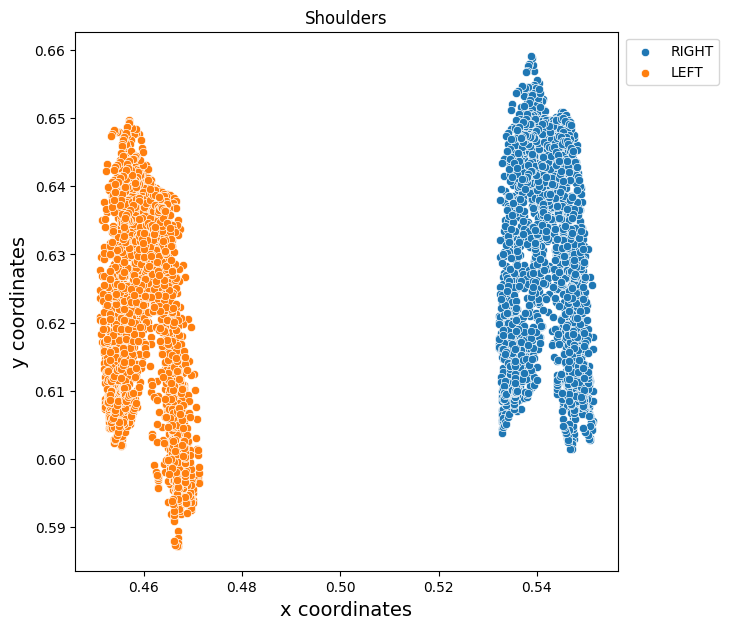

pulse:


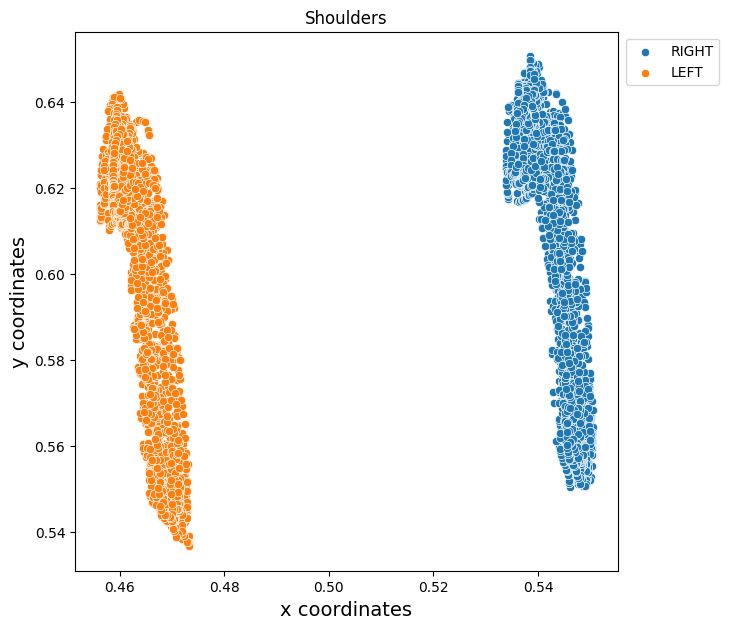

push:


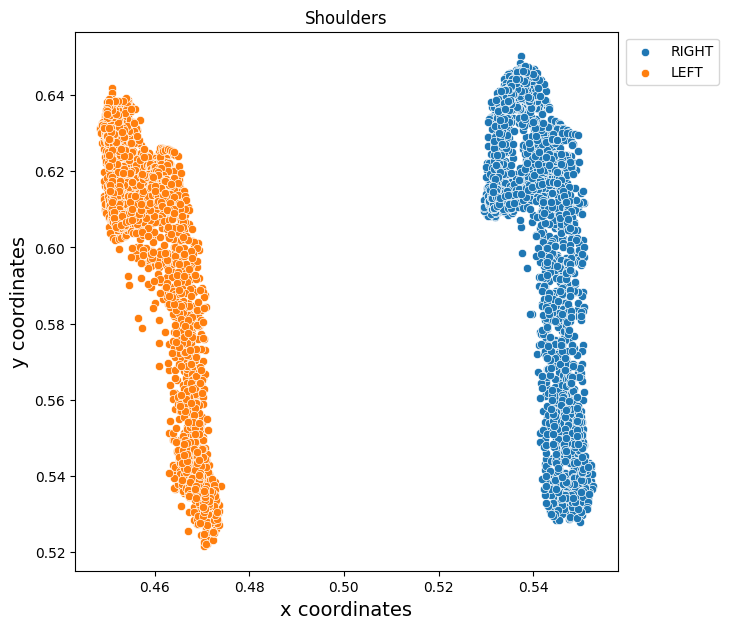

sexy_corners:


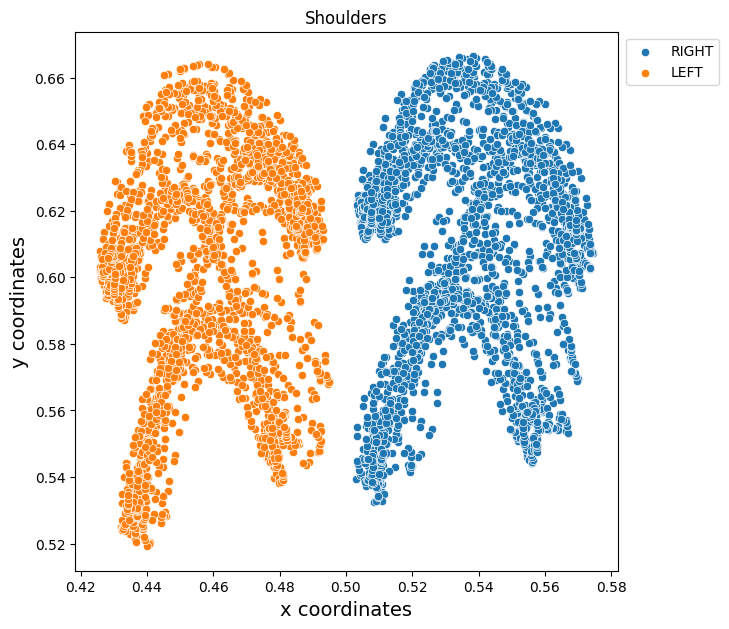

In [9]:
print('regular:')
plt.show(create_scatterplot(reg_shoulders, 'Shoulders'))
print('pulse:')
plt.show(create_scatterplot(pulse_shoulders, 'Shoulders'))
print('push:')
plt.show(create_scatterplot(push_shoulders, 'Shoulders'))
print('sexy_corners:')
plt.show(create_scatterplot(sc_shoulders, 'Shoulders'))

**x-coordinates**<br>
The x-coordinates of shoulders distinguish `sexy_corners` from `regular`, `pulse` and `push` as `sexy_corners` is the only move that require the rider to sway sideways. This is observed from the wider range in `sexy_corners` compared with the other classes.

**y-coordinates**<br>
The y-coordinates of shoulders distinguish `regular` from `pulse`, `push` and `sexy_corners` as it is the only move that does not require the rider to duck down. This is observed from the wider range in the other three classes.

**Overall**<br>
The shoulder coordinates best distinguishes `sexy_corners` from the rest. The `sexy_corners` scatterplot makes a clear illustration of the four corners in the move. While the other moves involves the rider bobbing up and down but to different extents, their scatterplots have a more linear presentation of the coordinates.

### Elbows
Same drill for the elbows.

In [10]:
# Split df_elbows by choreo
reg_elbows = df_elbows[df_elbows['choreo'] == 'regular']
pulse_elbows = df_elbows[df_elbows['choreo'] == 'pulse']
push_elbows = df_elbows[df_elbows['choreo'] == 'push']
sc_elbows = df_elbows[df_elbows['choreo'] == 'sexy_corners']

In [11]:
min_max_reg = reg_elbows.min(axis=0), reg_elbows.max(axis=0)
min_max_pulse = pulse_elbows.min(axis=0), pulse_elbows.max(axis=0)
min_max_push = push_elbows.min(axis=0), push_elbows.max(axis=0)
min_max_sc = sc_elbows.min(axis=0), sc_elbows.max(axis=0)

# Print results
print('=====================================')
print('regular:')
print()
for column in reg_elbows.columns[1:]:
    print(f'Min and max of {column}: {min_max_reg[0][column]:.2f}, {min_max_reg[1][column]:.2f}')

print('=====================================')
print('pulse:')
print()
for column in pulse_elbows.columns[1:]:
    print(f'Min and max of {column}: {min_max_pulse[0][column]:.2f}, {min_max_pulse[1][column]:.2f}')
    
print('=====================================')    
print('push:')
print()
for column in push_elbows.columns[1:]:
    print(f'Min and max of {column}: {min_max_push[0][column]:.2f}, {min_max_push[1][column]:.2f}')

print('=====================================')
print('sexy_corners:')
print()
for column in sc_elbows.columns[1:]:
    print(f'Min and max of {column}: {min_max_sc[0][column]:.2f}, {min_max_sc[1][column]:.2f}')

regular:

Min and max of x_RIGHT: 0.43, 0.45
Min and max of x_LEFT: 0.55, 0.56
Min and max of y_RIGHT: 0.43, 0.50
Min and max of y_LEFT: 0.43, 0.50
Min and max of v_RIGHT: 0.97, 0.99
Min and max of v_LEFT: 0.98, 0.99
pulse:

Min and max of x_RIGHT: 0.43, 0.45
Min and max of x_LEFT: 0.54, 0.57
Min and max of y_RIGHT: 0.43, 0.55
Min and max of y_LEFT: 0.43, 0.55
Min and max of v_RIGHT: 0.95, 0.99
Min and max of v_LEFT: 0.97, 0.99
push:

Min and max of x_RIGHT: 0.38, 0.44
Min and max of x_LEFT: 0.56, 0.60
Min and max of y_RIGHT: 0.42, 0.47
Min and max of y_LEFT: 0.43, 0.50
Min and max of v_RIGHT: 0.99, 1.00
Min and max of v_LEFT: 0.99, 1.00
sexy_corners:

Min and max of x_RIGHT: 0.41, 0.46
Min and max of x_LEFT: 0.53, 0.58
Min and max of y_RIGHT: 0.43, 0.55
Min and max of y_LEFT: 0.43, 0.57
Min and max of v_RIGHT: 0.95, 0.99
Min and max of v_LEFT: 0.95, 1.00


regular:


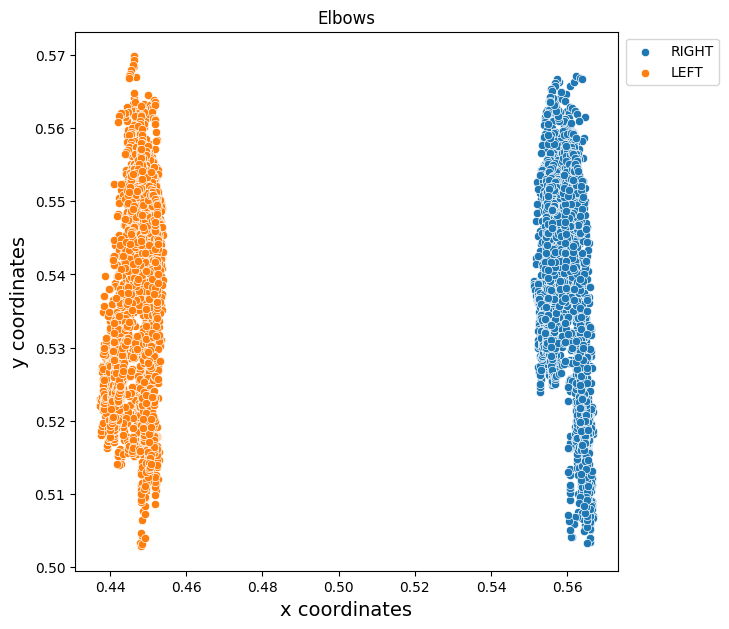

pulse:


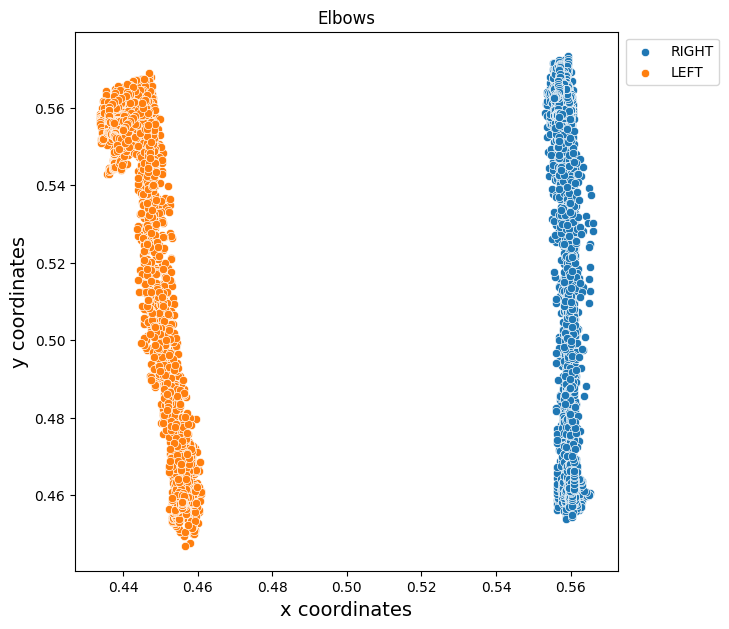

push:


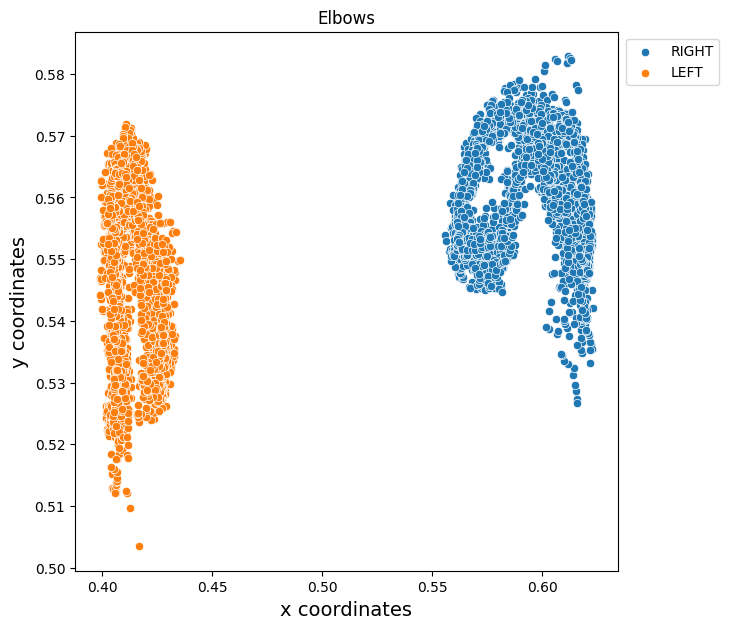

sexy_corners:


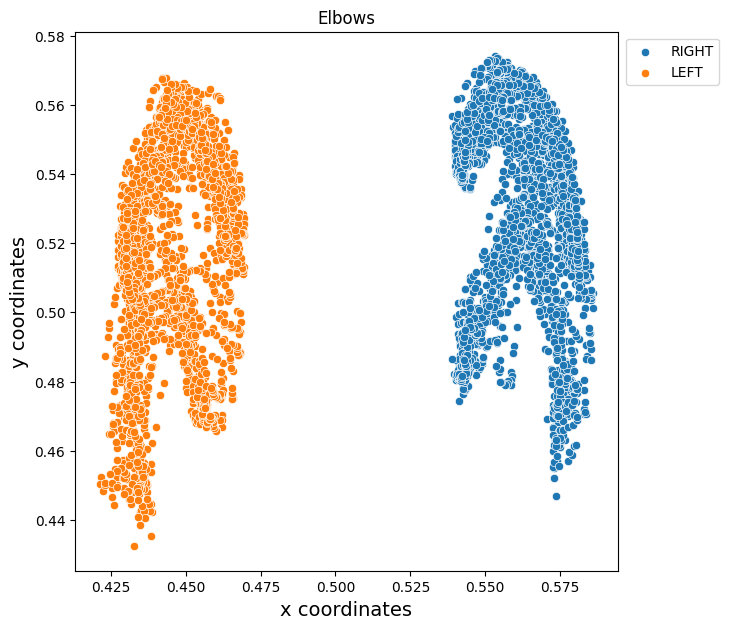

In [12]:
# Apply the same function to create scatterplots for elbows
print('regular:')
plt.show(create_scatterplot(reg_elbows, 'Elbows'))
print('pulse:')
plt.show(create_scatterplot(pulse_elbows, 'Elbows'))
print('push:')
plt.show(create_scatterplot(push_elbows, 'Elbows'))
print('sexy_corners:')
plt.show(create_scatterplot(sc_elbows, 'Elbows'))

**x-coordinates**<br>
The x-coordinates of elbows distinguish `regular` and `pulse` from `push` and `sexy_corners`. With no sideway movements invovled, `regular` and `pulse` have small ranges. On the other hand, `push` requires the rider to push down with the elbows wide open, hence resulting in a wide range. Though `sexy_corners` also has sideway movements, the movement is focused on swaying the body sideways rather than the elbow, so the range is smaller than those of `push`.

**y-coordinates**<br>
The y-coordinates of elbows distinguish `regular` and `push` from `pulse` and `sexy_corners`. In `push`, the rider's elbows are locked on the handle bar while they push their chest downwards according to the beat. Thus, the vertical range is limited, just like `regular` where the rider just rides on the spot. As both `pulse` and `sexy_corners` require the rider to crunch their body, their elbows are lowered significantly, resulting in a wider vertical range.

**Overall**<br>
While `sexy_corners` remains the most distinguishable because of the four corners, the larger shoulder range compared to elbow range in the scatterplots is another significant trait that identifies `push`. Unlike the other moves where the shoulder ranges are proportionate to the elbow ranges, the shoulders have a greater vertical range than the elbows in `push`. 

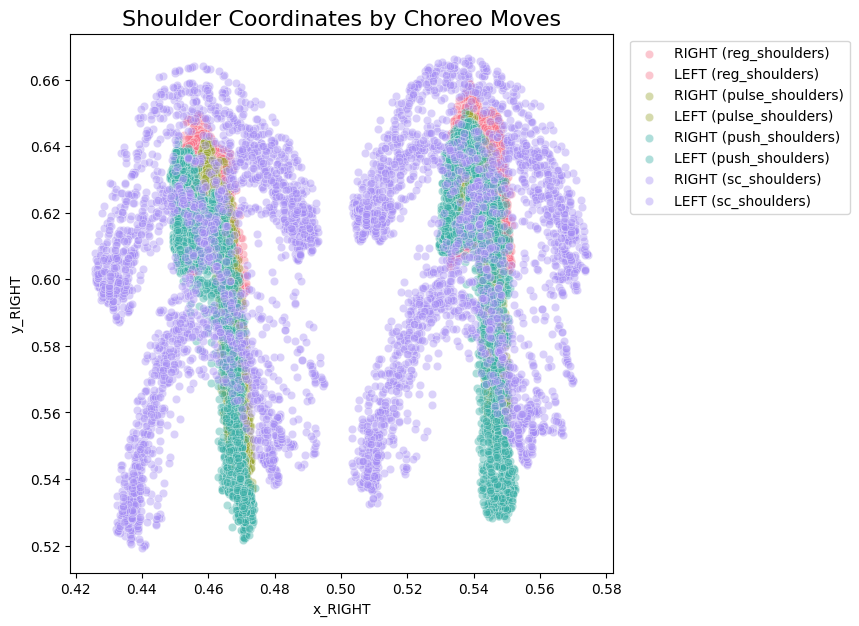

In [13]:
# Create a list of the dataframes and their corresponding labels
dataframes = [reg_shoulders, pulse_shoulders, push_shoulders, sc_shoulders]
labels = ['reg_shoulders', 'pulse_shoulders', 'push_shoulders', 'sc_shoulders']

# Define a color palette for each dataset
palettes = sns.color_palette('husl', len(dataframes))

# Set figure size
plt.figure(figsize=(7, 7))

for df, label, palette in zip(dataframes, labels, palettes):
    
    # Use the same palette for both left and right, but different for each move
    sns.scatterplot(data=df, x=1 - df['x_RIGHT'], y=1 - df['y_RIGHT'], label=f'RIGHT ({label})', color=palette, alpha=0.4)
    sns.scatterplot(data=df, x=1 - df['x_LEFT'], y=1 - df['y_LEFT'], label=f'LEFT ({label})', color=palette, alpha=0.4)

# Add plot title
plt.title('Shoulder Coordinates by Choreo Moves', size=16)

# Set the legend position
plt.legend(bbox_to_anchor=(1.45, 1), loc='upper right')

plt.show()

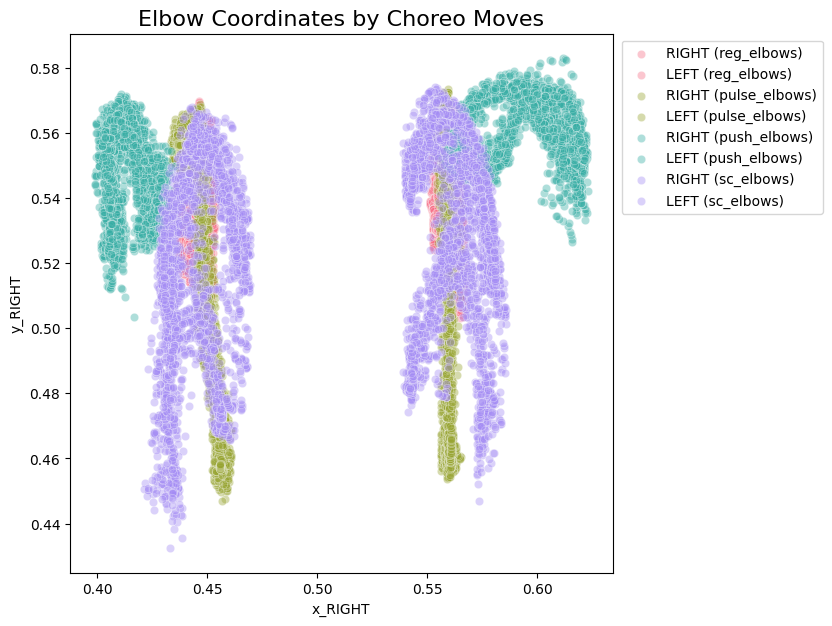

In [14]:
# Create a list of the dataframes and their corresponding labels
dfs = [reg_elbows, pulse_elbows, push_elbows, sc_elbows]
labels = ['reg_elbows', 'pulse_elbows', 'push_elbows', 'sc_elbows']

# Define a color palette for each dataset
palettes = sns.color_palette('husl', len(dataframes))

# Set figure size
plt.figure(figsize=(7, 7))

for df, label, palette in zip(dfs, labels, palettes):
    
    # Use the same palette for both left and right, but different for each move
    sns.scatterplot(data=df, x=1 - df['x_RIGHT'], y=1 - df['y_RIGHT'], label=f'RIGHT ({label})', color=palette, alpha=0.4)
    sns.scatterplot(data=df, x=1 - df['x_LEFT'], y=1 - df['y_LEFT'], label=f'LEFT ({label})', color=palette, alpha=0.4)

# Add plot title
plt.title('Elbow Coordinates by Choreo Moves', size=16)

# Set the legend position
plt.legend(bbox_to_anchor=(1.4, 1), loc='upper right')

plt.show()

### Feature Selection

In [15]:
# Check current number of features
len(df_choreo.columns) - 1

135

Currently, there are 135 features which is a lot. Before running the tests, I will be doing an initial clean up of features that are insignificant or irrelevant.

In spin, the different moves are determined by body movements, not facial features. All facial features should be dropped to place more focus on the body landmarks. According to the landmark index below, columns of index 2 to 45 shall be eliminated.

In [16]:
# Enumerate the columns for filtering
for i, column in enumerate(df_choreo.columns):
    print(i, column)

0 choreo
1 timestamp
2 x_NOSE
3 y_NOSE
4 z_NOSE
5 v_NOSE
6 x_LEFT_EYE_INNER
7 y_LEFT_EYE_INNER
8 z_LEFT_EYE_INNER
9 v_LEFT_EYE_INNER
10 x_LEFT_EYE
11 y_LEFT_EYE
12 z_LEFT_EYE
13 v_LEFT_EYE
14 x_LEFT_EYE_OUTER
15 y_LEFT_EYE_OUTER
16 z_LEFT_EYE_OUTER
17 v_LEFT_EYE_OUTER
18 x_RIGHT_EYE_INNER
19 y_RIGHT_EYE_INNER
20 z_RIGHT_EYE_INNER
21 v_RIGHT_EYE_INNER
22 x_RIGHT_EYE
23 y_RIGHT_EYE
24 z_RIGHT_EYE
25 v_RIGHT_EYE
26 x_RIGHT_EYE_OUTER
27 y_RIGHT_EYE_OUTER
28 z_RIGHT_EYE_OUTER
29 v_RIGHT_EYE_OUTER
30 x_LEFT_EAR
31 y_LEFT_EAR
32 z_LEFT_EAR
33 v_LEFT_EAR
34 x_RIGHT_EAR
35 y_RIGHT_EAR
36 z_RIGHT_EAR
37 v_RIGHT_EAR
38 x_MOUTH_LEFT
39 y_MOUTH_LEFT
40 z_MOUTH_LEFT
41 v_MOUTH_LEFT
42 x_MOUTH_RIGHT
43 y_MOUTH_RIGHT
44 z_MOUTH_RIGHT
45 v_MOUTH_RIGHT
46 x_LEFT_SHOULDER
47 y_LEFT_SHOULDER
48 z_LEFT_SHOULDER
49 v_LEFT_SHOULDER
50 x_RIGHT_SHOULDER
51 y_RIGHT_SHOULDER
52 z_RIGHT_SHOULDER
53 v_RIGHT_SHOULDER
54 x_LEFT_ELBOW
55 y_LEFT_ELBOW
56 z_LEFT_ELBOW
57 v_LEFT_ELBOW
58 x_RIGHT_ELBOW
59 y_RIGHT_ELBOW
6

In [17]:
df_choreo = df_choreo.drop(df_choreo.iloc[:, 2:46], axis=1)
df_choreo.head()

,choreo,timestamp,x_LEFT_SHOULDER,y_LEFT_SHOULDER,z_LEFT_SHOULDER,v_LEFT_SHOULDER,x_RIGHT_SHOULDER,y_RIGHT_SHOULDER,z_RIGHT_SHOULDER,v_RIGHT_SHOULDER,x_LEFT_ELBOW,y_LEFT_ELBOW,z_LEFT_ELBOW,v_LEFT_ELBOW,x_RIGHT_ELBOW,y_RIGHT_ELBOW,z_RIGHT_ELBOW,v_RIGHT_ELBOW,x_LEFT_WRIST,y_LEFT_WRIST,z_LEFT_WRIST,v_LEFT_WRIST,x_RIGHT_WRIST,y_RIGHT_WRIST,z_RIGHT_WRIST,v_RIGHT_WRIST,x_LEFT_PINKY,y_LEFT_PINKY,z_LEFT_PINKY,v_LEFT_PINKY,x_RIGHT_PINKY,y_RIGHT_PINKY,z_RIGHT_PINKY,v_RIGHT_PINKY,x_LEFT_INDEX,y_LEFT_INDEX,z_LEFT_INDEX,v_LEFT_INDEX,x_RIGHT_INDEX,y_RIGHT_INDEX,z_RIGHT_INDEX,v_RIGHT_INDEX,x_LEFT_THUMB,y_LEFT_THUMB,z_LEFT_THUMB,v_LEFT_THUMB,x_RIGHT_THUMB,y_RIGHT_THUMB,z_RIGHT_THUMB,v_RIGHT_THUMB,x_LEFT_HIP,y_LEFT_HIP,z_LEFT_HIP,v_LEFT_HIP,x_RIGHT_HIP,y_RIGHT_HIP,z_RIGHT_HIP,v_RIGHT_HIP,x_LEFT_KNEE,y_LEFT_KNEE,z_LEFT_KNEE,v_LEFT_KNEE,x_RIGHT_KNEE,y_RIGHT_KNEE,z_RIGHT_KNEE,v_RIGHT_KNEE,x_LEFT_ANKLE,y_LEFT_ANKLE,z_LEFT_ANKLE,v_LEFT_ANKLE,x_RIGHT_ANKLE,y_RIGHT_ANKLE,z_RIGHT_ANKLE,v_RIGHT_ANKLE,x_LEFT_HEEL,y_LEFT_HEEL,z_LEFT_HEEL,v_LEFT_HEEL,x_RIGHT_HEEL,y_RIGHT_HEEL,z_RIGHT_HEEL,v_RIGHT_HEEL,x_LEFT_FOOT_INDEX,y_LEFT_FOOT_INDEX,z_LEFT_FOOT_INDEX,v_LEFT_FOOT_INDEX,x_RIGHT_FOOT_INDEX,y_RIGHT_FOOT_INDEX,z_RIGHT_FOOT_INDEX,v_RIGHT_FOOT_INDEX,prompts,choreo_results
0,regular,0.02,0.541419,0.392366,-0.053509,0.999997,0.462078,0.386223,-0.044752,0.999972,0.557617,0.475867,-0.074800,0.990922,0.441858,0.465039,-0.064400,0.988470,0.580738,0.516422,-0.184602,0.996360,0.418855,0.508430,-0.163661,0.994022,0.591834,0.527058,-0.207297,0.993728,0.406513,0.516427,-0.183632,0.989500,0.590868,0.521594,-0.223747,0.994577,0.408786,0.511276,-0.200111,0.990705,0.586395,0.517875,-0.194346,0.994155,0.414112,0.510042,-0.173362,0.990837,0.518879,0.563852,-0.009890,0.999965,0.476228,0.557246,0.009776,0.999897,0.513578,0.707357,-0.005310,0.980009,0.458764,0.650263,0.022100,0.960495,0.516013,0.827558,0.055844,0.988360,0.461598,0.725048,0.170757,0.862985,0.513719,0.841829,0.058415,0.841601,0.467540,0.729058,0.184190,0.613609,0.521440,0.885349,-0.001563,0.979084,0.452877,0.788873,0.160094,0.868487,regular,0
1,regular,0.03,0.540996,0.389465,-0.051307,0.999997,0.461874,0.384727,-0.044523,0.999971,0.556646,0.469219,-0.073138,0.991014,0.442254,0.462587,-0.064568,0.988266,0.580445,0.515708,-0.182032,0.996376,0.419424,0.505592,-0.165914,0.993942,0.591622,0.526858,-0.205108,0.993691,0.407036,0.515687,-0.187853,0.989323,0.590167,0.521289,-0.221396,0.994541,0.408912,0.509605,-0.204493,0.990550,0.585598,0.517541,-0.191832,0.994130,0.414339,0.507484,-0.176052,0.990707,0.518512,0.559169,-0.009030,0.999963,0.475744,0.553247,0.008946,0.999893,0.513624,0.700489,-0.005294,0.979306,0.458897,0.645623,-0.004006,0.961082,0.516008,0.825135,0.051275,0.988211,0.460512,0.729781,0.122572,0.868536,0.513620,0.839855,0.052638,0.839212,0.465679,0.734242,0.132874,0.620871,0.515420,0.882208,-0.009656,0.978718,0.453300,0.799274,0.098816,0.872919,regular,0
2,regular,0.05,0.540826,0.388734,-0.037161,0.999997,0.461517,0.384322,-0.034168,0.999971,0.556186,0.467201,-0.061071,0.991214,0.442264,0.461699,-0.054635,0.988258,0.580063,0.515109,-0.165798,0.996363,0.419573,0.504849,-0.155548,0.993853,0.591379,0.526483,-0.187443,0.993622,0.407284,0.515651,-0.178401,0.989121,0.589623,0.520816,-0.203381,0.994461,0.409020,0.509139,-0.194209,0.990339,0.585003,0.517065,-0.175441,0.994047,0.414507,0.506729,-0.165454,0.990503,0.518492,0.557112,-0.007194,0.999961,0.475173,0.551551,0.007145,0.999892,0.513556,0.697486,-0.029194,0.979126,0.458899,0.634951,-0.073712,0.962403,0.515983,0.822726,0.028833,0.988076,0.459674,0.729524,0.052112,0.875531,0.513547,0.837489,0.030104,0.837120,0.464441,0.734082,0.061998,0.632482,0.511299,0.879375,-0.034654,0.978292,0.453598,0.798270,0.020789,0.879583,regular,0
3,regular,0.07,0.540303,0.384647,-0.037712,0.999997,0.460975,0.380907,-0.030757,0.999968,0.555406,0.462021,-0.063634,0.991268,0.442263,0.460053,-0.054803,0.987437,0.579651,0.513027,-0.170790,0.996252,0.419846,0.503819,-0.156596,0.993483,0.59

In the 'Coordinates' section, the v-coordinates were consistently high. I would like to check if this is the same for the other v-coordinates as well.

In [18]:
# Get column names containing 'v_'
v_coord_col = [col for col in df_choreo.columns if 'v_' in col]

In [19]:
# Find minimum values of these columns and arrange in ascending order
print(df_choreo[v_coord_col].min().sort_values(ascending=True))

v_RIGHT_HEEL          0.304616
v_LEFT_HEEL           0.477830
v_RIGHT_ANKLE         0.533624
v_RIGHT_FOOT_INDEX    0.565892
v_LEFT_ANKLE          0.644788
v_LEFT_FOOT_INDEX     0.696054
v_RIGHT_THUMB         0.737612
v_LEFT_KNEE           0.739869
v_RIGHT_INDEX         0.767141
v_RIGHT_PINKY         0.772104
v_LEFT_THUMB          0.839552
v_RIGHT_KNEE          0.859656
v_LEFT_PINKY          0.871265
v_LEFT_INDEX          0.886578
v_RIGHT_WRIST         0.913309
v_RIGHT_ELBOW         0.946561
v_LEFT_ELBOW          0.947999
v_LEFT_WRIST          0.948071
v_LEFT_HIP            0.991908
v_RIGHT_HIP           0.997921
v_RIGHT_SHOULDER      0.999893
v_LEFT_SHOULDER       0.999957
dtype: float64


While most v_coordinates are high (i.e. >0.9), the pinkies, indexes, thumbs, knees, ankles, foot indexes and heels have fairly low confidence levels. It makes sense that Mediapipe was not very confident of predicting these landmarks because the camera was placed at a distance good enough to capture the wider body movements (e.g. shoulder and arm movements) but not these smaller details. 

I will **drop all the coordinates of pinkies, indexes, thumbs, knees, ankles, foot indexes and heels** to reduce noise. I will also be **dropping the remaining v-coordinates** as their low variance would not bring impactful insights to the analysis.

In [20]:
# Drop columns containing 'v_'
df_choreo.drop(df_choreo[v_coord_col], axis=1, inplace=True)

In [21]:
# Get column names containing 'pinky', 'index', 'thumb', 'knee', 'ankle' and 'heel'
small_landmarks_col = [col for col in df_choreo.columns if any(landmark in col for landmark in ['PINKY', 'INDEX', 'THUMB', 'KNEE', 'ANKLE', 'HEEL'])]

print(small_landmarks_col)

['x_LEFT_PINKY', 'y_LEFT_PINKY', 'z_LEFT_PINKY', 'x_RIGHT_PINKY', 'y_RIGHT_PINKY', 'z_RIGHT_PINKY', 'x_LEFT_INDEX', 'y_LEFT_INDEX', 'z_LEFT_INDEX', 'x_RIGHT_INDEX', 'y_RIGHT_INDEX', 'z_RIGHT_INDEX', 'x_LEFT_THUMB', 'y_LEFT_THUMB', 'z_LEFT_THUMB', 'x_RIGHT_THUMB', 'y_RIGHT_THUMB', 'z_RIGHT_THUMB', 'x_LEFT_KNEE', 'y_LEFT_KNEE', 'z_LEFT_KNEE', 'x_RIGHT_KNEE', 'y_RIGHT_KNEE', 'z_RIGHT_KNEE', 'x_LEFT_ANKLE', 'y_LEFT_ANKLE', 'z_LEFT_ANKLE', 'x_RIGHT_ANKLE', 'y_RIGHT_ANKLE', 'z_RIGHT_ANKLE', 'x_LEFT_HEEL', 'y_LEFT_HEEL', 'z_LEFT_HEEL', 'x_RIGHT_HEEL', 'y_RIGHT_HEEL', 'z_RIGHT_HEEL', 'x_LEFT_FOOT_INDEX', 'y_LEFT_FOOT_INDEX', 'z_LEFT_FOOT_INDEX', 'x_RIGHT_FOOT_INDEX', 'y_RIGHT_FOOT_INDEX', 'z_RIGHT_FOOT_INDEX']


In [22]:
# Drop small_landmarks_col
df_choreo.drop(df_choreo[small_landmarks_col], axis=1, inplace=True)
df_choreo.columns

Index(['choreo', 'timestamp', 'x_LEFT_SHOULDER', 'y_LEFT_SHOULDER',
       'z_LEFT_SHOULDER', 'x_RIGHT_SHOULDER', 'y_RIGHT_SHOULDER',
       'z_RIGHT_SHOULDER', 'x_LEFT_ELBOW', 'y_LEFT_ELBOW', 'z_LEFT_ELBOW',
       'x_RIGHT_ELBOW', 'y_RIGHT_ELBOW', 'z_RIGHT_ELBOW', 'x_LEFT_WRIST',
       'y_LEFT_WRIST', 'z_LEFT_WRIST', 'x_RIGHT_WRIST', 'y_RIGHT_WRIST',
       'z_RIGHT_WRIST', 'x_LEFT_HIP', 'y_LEFT_HIP', 'z_LEFT_HIP',
       'x_RIGHT_HIP', 'y_RIGHT_HIP', 'z_RIGHT_HIP', 'prompts',
       'choreo_results'],
      dtype='object')

### Create dummies
Next, I would be creating dummies for the categorical variables, `choreo` and `prompts` as machine learning models can only read numerical values.

In [23]:
# Create dummies for 'choreo' and 'prompts' since they are categorical variables
choreo_dummies = pd.get_dummies(df_choreo[['choreo']])
prompts_dummies = pd.get_dummies(df_choreo[['prompts']])

# Combine them into a dataframe
dummies_df = pd.concat([choreo_dummies, prompts_dummies], axis=1)

# Convert the True/False boolean into 0/1
dummies_df = dummies_df * 1

dummies_df.head()

,choreo_pulse,choreo_push,choreo_regular,choreo_sexy_corners,prompts_pulse,prompts_push,prompts_regular,prompts_sexy_corners
0,0,0,1,0,0,0,1,0
1,0,0,1,0,0,0,1,0
2,0,0,1,0,0,0,1,0
3,0,0,1,0,0,0,1,0
4,0,0,1,0,0,0,1,0


In [24]:
# Combine the dummies df with df_choreo
df_choreo = pd.concat([df_choreo, dummies_df], axis=1)

# Drop the original 'choreo' and 'prompts' columns
df_choreo = df_choreo.drop(['choreo', 'prompts'], axis=1)

# Print
display(df_choreo.head())

,timestamp,x_LEFT_SHOULDER,y_LEFT_SHOULDER,z_LEFT_SHOULDER,x_RIGHT_SHOULDER,y_RIGHT_SHOULDER,z_RIGHT_SHOULDER,x_LEFT_ELBOW,y_LEFT_ELBOW,z_LEFT_ELBOW,x_RIGHT_ELBOW,y_RIGHT_ELBOW,z_RIGHT_ELBOW,x_LEFT_WRIST,y_LEFT_WRIST,z_LEFT_WRIST,x_RIGHT_WRIST,y_RIGHT_WRIST,z_RIGHT_WRIST,x_LEFT_HIP,y_LEFT_HIP,z_LEFT_HIP,x_RIGHT_HIP,y_RIGHT_HIP,z_RIGHT_HIP,choreo_results,choreo_pulse,choreo_push,choreo_regular,choreo_sexy_corners,prompts_pulse,prompts_push,prompts_regular,prompts_sexy_corners
0,0.02,0.541419,0.392366,-0.053509,0.462078,0.386223,-0.044752,0.557617,0.475867,-0.074800,0.441858,0.465039,-0.064400,0.580738,0.516422,-0.184602,0.418855,0.508430,-0.163661,0.518879,0.563852,-0.009890,0.476228,0.557246,0.009776,0,0,0,1,0,0,0,1,0
1,0.03,0.540996,0.389465,-0.051307,0.461874,0.384727,-0.044523,0.556646,0.469219,-0.073138,0.442254,0.462587,-0.064568,0.580445,0.515708,-0.182032,0.419424,0.505592,-0.165914,0.518512,0.559169,-0.009030,0.475744,0.553247,0.008946,0,0,0,1,0,0,0,1,0
2,0.05,0.540826,0.388734,-0.037161,0.461517,0.384322,-0.034168,0.556186,0.467201,-0.061071,0.442264,0.461699,-0.054635,0.580063,0.515109,-0.165798,0.419573,0.504849,-0.155548,0.518492,0.557112,-0.007194,0.475173,0.551551,0.007145,0,0,0,1,0,0,0,1,0
3,0.07,0.540303,0.384647,-0.037712,0.460975,0.380907,-0.030757,0.555406,0.462021,-0.063634,0.442263,0.460053,-0.054803,0.579651,0.513027,-0.170790,0.419846,0.503819,-0.156596,0.517737,0.554749,-0.009183,0.474261,0.550249,0.009147,0,0,0,1,0,0,0,1,0
4,0.08,0.540040,0.382849,-0.034311,0.460749,0.378938,-0.026509,0.554802,0.459173,-0.060671,0.442541,0.457827,-0.052544,0.579094,0.511752,-0.170025,0.420444,0.502329,-0.157378,0.517351,0.553686,-0.009315,0.474009,0.548582,0.009286,0,0,0,1,0,0,0,1,0


In [25]:
# Check current number of features
len(df_choreo.columns) - 1

33

### Correlation Test
Down to 66 features, we shall proceed with the correlation test to eliminate the remaining features that are collinear.
### Colinearity
`choreo_results` is dropped in this section to study the collinearity of the features.

In [26]:
# Create a new df for collinearity check
collinear_check = df_choreo.drop('choreo_results', axis=1)

In [27]:
# Generate correlation coefficients
choreo_corr = collinear_check.corr()

Given the large number of features, it would be hard to read the results from a correlation matrix. I have reorganised the results, such that only the top 10 values are shown along with their variable pairs.

I have set 0.9 as the threshold to determine variables with high collinearity (r ≥ 0.9). A high threshold is necessary. Considering that most of our body parts move in the same direction, I foresee high multicollinearity across the features.

In [28]:
# Reorganise results in descending order
high_corr = choreo_corr[choreo_corr >= 0.9]
high_corr = high_corr.unstack().dropna().reset_index()
high_corr.columns = ['Variable 1', 'Variable 2', 'Correlation']
high_corr = high_corr[high_corr['Variable 1'] != high_corr['Variable 2']]

print(f'{len(high_corr) // 2} pairs of collinear features') # Divide by 2 as the reverse order of variables are shown as well
display(high_corr.sort_values(by='Correlation', ascending=False).head(10))
print('Variable 1:')
display(high_corr['Variable 1'].unique())
print('Variable 2:')
display(high_corr['Variable 2'].unique())

22 pairs of collinear features


,Variable 1,Variable 2,Correlation
18,z_RIGHT_SHOULDER,z_LEFT_SHOULDER,0.989414
8,z_LEFT_SHOULDER,z_RIGHT_SHOULDER,0.989414
64,x_RIGHT_HIP,x_LEFT_HIP,0.982222
58,x_LEFT_HIP,x_RIGHT_HIP,0.982222
6,y_LEFT_SHOULDER,y_RIGHT_SHOULDER,0.981633
16,y_RIGHT_SHOULDER,y_LEFT_SHOULDER,0.981633
9,z_LEFT_SHOULDER,z_LEFT_ELBOW,0.973281
27,z_LEFT_ELBOW,z_LEFT_SHOULDER,0.973281
31,z_LEFT_ELBOW,z_LEFT_WRIST,0.972090
47,z_LEFT_WRIST,z_LEFT_ELBOW,0.972090


Variable 1:


array(['x_LEFT_SHOULDER', 'y_LEFT_SHOULDER', 'z_LEFT_SHOULDER',
       'x_RIGHT_SHOULDER', 'y_RIGHT_SHOULDER', 'z_RIGHT_SHOULDER',
       'x_LEFT_ELBOW', 'y_LEFT_ELBOW', 'z_LEFT_ELBOW', 'x_RIGHT_ELBOW',
       'y_RIGHT_ELBOW', 'z_RIGHT_ELBOW', 'x_LEFT_WRIST', 'z_LEFT_WRIST',
       'x_RIGHT_WRIST', 'z_RIGHT_WRIST', 'x_LEFT_HIP', 'y_LEFT_HIP',
       'x_RIGHT_HIP', 'y_RIGHT_HIP'], dtype=object)

Variable 2:


array(['x_RIGHT_SHOULDER', 'x_LEFT_HIP', 'x_RIGHT_HIP',
       'y_RIGHT_SHOULDER', 'z_RIGHT_SHOULDER', 'z_LEFT_ELBOW',
       'z_RIGHT_ELBOW', 'z_LEFT_WRIST', 'x_LEFT_SHOULDER',
       'y_LEFT_SHOULDER', 'z_LEFT_SHOULDER', 'x_LEFT_WRIST',
       'y_RIGHT_ELBOW', 'x_RIGHT_WRIST', 'y_LEFT_ELBOW', 'z_RIGHT_WRIST',
       'x_LEFT_ELBOW', 'x_RIGHT_ELBOW', 'y_RIGHT_HIP', 'y_LEFT_HIP'],
      dtype=object)

Out of the 22 collinear features, most of them are the opposite side of the same landmark because those landmarks are symmetrical in most of the choreography. As the right side is a common dominant side, also the side that most choreographies begin on, we shall eliminate all the left landmarks that are remaining.

In [29]:
# Get column names containing 'LEFT'
LEFT_col = [col for col in df_choreo.columns if 'LEFT' in col]

In [30]:
# Drop LEFT_col
df_choreo.drop(df_choreo[LEFT_col], axis=1, inplace=True)

# Show remaining columns
print(len(df_choreo.columns))
display(df_choreo.columns)

22


Index(['timestamp', 'x_RIGHT_SHOULDER', 'y_RIGHT_SHOULDER', 'z_RIGHT_SHOULDER',
       'x_RIGHT_ELBOW', 'y_RIGHT_ELBOW', 'z_RIGHT_ELBOW', 'x_RIGHT_WRIST',
       'y_RIGHT_WRIST', 'z_RIGHT_WRIST', 'x_RIGHT_HIP', 'y_RIGHT_HIP',
       'z_RIGHT_HIP', 'choreo_results', 'choreo_pulse', 'choreo_push',
       'choreo_regular', 'choreo_sexy_corners', 'prompts_pulse',
       'prompts_push', 'prompts_regular', 'prompts_sexy_corners'],
      dtype='object')

Through elimination methods, we've derived at a list of 21 features which consists of the right shoulder, elbow, wrist and hip coordinates. It makes sense that these are the remaining features considering how most choreography moves are variations of these landmarks' movements.

To check which features can help distinguish the different moves, I will be checking the correlation between the `choreo_` moves and the landmarks.

### Correlation between the moves and the landmarks
This time, the threshold is set at r ≥ 0.1 since the coefficients are generally low. The usefulness of a coordinate for identifying each choreography move would be based on relative values, specifically, any r ≥ 0.1.

In [31]:
df_choreo.corr()[df_choreo.corr() >= 0.1].iloc[-8:-4, :-4]

,timestamp,x_RIGHT_SHOULDER,y_RIGHT_SHOULDER,z_RIGHT_SHOULDER,x_RIGHT_ELBOW,y_RIGHT_ELBOW,z_RIGHT_ELBOW,x_RIGHT_WRIST,y_RIGHT_WRIST,z_RIGHT_WRIST,x_RIGHT_HIP,y_RIGHT_HIP,z_RIGHT_HIP,choreo_results,choreo_pulse,choreo_push,choreo_regular,choreo_sexy_corners
choreo_pulse,NaN,NaN,NaN,0.205021,0.291175,0.247453,0.123166,0.369065,NaN,NaN,NaN,NaN,0.128939,NaN,1.0,NaN,NaN,NaN
choreo_push,NaN,NaN,0.191433,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN
choreo_regular,NaN,NaN,NaN,0.278760,0.276144,NaN,0.318349,0.416762,0.135342,0.303276,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN
choreo_sexy_corners,NaN,0.179758,NaN,NaN,0.186518,0.232127,NaN,NaN,0.169053,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0


Text(0.5, 1.0, 'Correlation Between Choreo Moves and Landmarks')

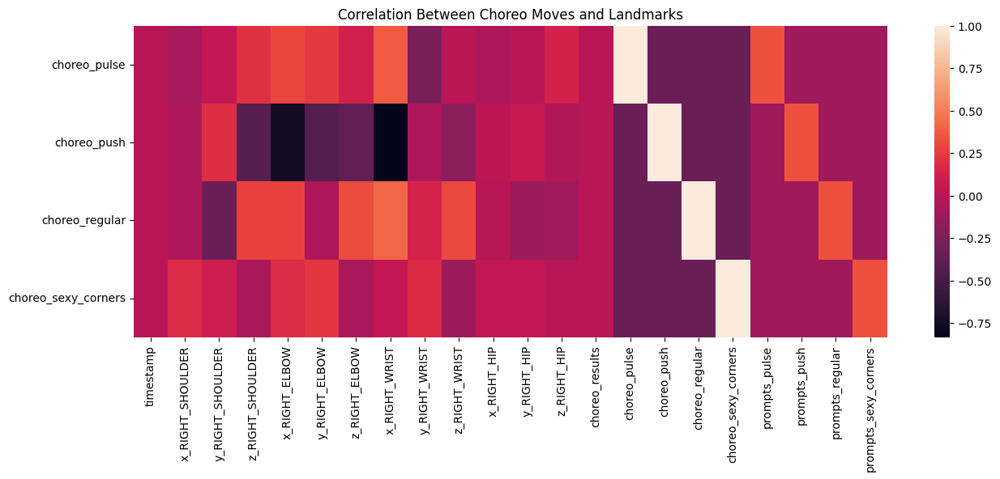

In [32]:
# Plot heatmap of the correlation coefficients
plt.figure(figsize=(15,5))
sns.heatmap(df_choreo.corr().iloc[-8:-4, :], annot=False)
plt.title('Correlation Between Choreo Moves and Landmarks')

I had thought that the z-coordinates might not come in handy since the camera angle was front-facing. From the correlation test above, it appears that the z-coordinates play a significant role in identifying the moves. 

To include the third dimension, I would like to create two new features, the `shoulder_angle` and `elbow_angle`, while making use of the remaining landmarks.

`shoulder_angle` - hip-shoulder-elbow
`elbow_angle` - shoulder-elbow-wrist

### 3. Feature Engineering
### Angles

In [33]:
# Creat new dataframes for each move containing the coordinates in the angle_column list
angle_columns = ['x_RIGHT_SHOULDER', 'y_RIGHT_SHOULDER', 'z_RIGHT_SHOULDER',
                 'x_RIGHT_ELBOW', 'y_RIGHT_ELBOW', 'z_RIGHT_ELBOW',
                 'x_RIGHT_WRIST', 'y_RIGHT_WRIST', 'z_RIGHT_WRIST',
                 'x_RIGHT_HIP', 'y_RIGHT_HIP', 'z_RIGHT_HIP'
                ]

reg_angle_coords = df_choreo[df_choreo['choreo_regular'] == 0][angle_columns].reset_index(drop=True)
pulse_angle_coords = df_choreo[df_choreo['choreo_pulse'] == 0][angle_columns].reset_index(drop=True)
push_angle_coords = df_choreo[df_choreo['choreo_push'] == 0][angle_columns].reset_index(drop=True)
sc_angle_coords = df_choreo[df_choreo['choreo_sexy_corners'] == 0][angle_columns].reset_index(drop=True)

# Display
print('reg_angle_coords')
display(reg_angle_coords.head(3))
print()
print('pulse_angle_coords')
display(pulse_angle_coords.head(3))
print()
print('push_angle_coords')
display(push_angle_coords.head(3))
print()
print('sc_angle_coords')
display(sc_angle_coords.head(3))

reg_angle_coords


,x_RIGHT_SHOULDER,y_RIGHT_SHOULDER,z_RIGHT_SHOULDER,x_RIGHT_ELBOW,y_RIGHT_ELBOW,z_RIGHT_ELBOW,x_RIGHT_WRIST,y_RIGHT_WRIST,z_RIGHT_WRIST,x_RIGHT_HIP,y_RIGHT_HIP,z_RIGHT_HIP
0,0.462140,0.354798,-0.001343,0.442697,0.438472,-0.030834,0.421002,0.488988,-0.138229,0.474328,0.532425,0.006576
1,0.462035,0.355072,-0.022112,0.442745,0.437827,-0.037722,0.420691,0.489337,-0.135966,0.474857,0.531107,0.006326
2,0.462083,0.355555,-0.019329,0.442985,0.436302,-0.049518,0.420694,0.489239,-0.162469,0.474816,0.531207,0.002217



pulse_angle_coords


,x_RIGHT_SHOULDER,y_RIGHT_SHOULDER,z_RIGHT_SHOULDER,x_RIGHT_ELBOW,y_RIGHT_ELBOW,z_RIGHT_ELBOW,x_RIGHT_WRIST,y_RIGHT_WRIST,z_RIGHT_WRIST,x_RIGHT_HIP,y_RIGHT_HIP,z_RIGHT_HIP
0,0.462078,0.386223,-0.044752,0.441858,0.465039,-0.064400,0.418855,0.508430,-0.163661,0.476228,0.557246,0.009776
1,0.461874,0.384727,-0.044523,0.442254,0.462587,-0.064568,0.419424,0.505592,-0.165914,0.475744,0.553247,0.008946
2,0.461517,0.384322,-0.034168,0.442264,0.461699,-0.054635,0.419573,0.504849,-0.155548,0.475173,0.551551,0.007145



push_angle_coords


,x_RIGHT_SHOULDER,y_RIGHT_SHOULDER,z_RIGHT_SHOULDER,x_RIGHT_ELBOW,y_RIGHT_ELBOW,z_RIGHT_ELBOW,x_RIGHT_WRIST,y_RIGHT_WRIST,z_RIGHT_WRIST,x_RIGHT_HIP,y_RIGHT_HIP,z_RIGHT_HIP
0,0.462078,0.386223,-0.044752,0.441858,0.465039,-0.064400,0.418855,0.508430,-0.163661,0.476228,0.557246,0.009776
1,0.461874,0.384727,-0.044523,0.442254,0.462587,-0.064568,0.419424,0.505592,-0.165914,0.475744,0.553247,0.008946
2,0.461517,0.384322,-0.034168,0.442264,0.461699,-0.054635,0.419573,0.504849,-0.155548,0.475173,0.551551,0.007145



sc_angle_coords


,x_RIGHT_SHOULDER,y_RIGHT_SHOULDER,z_RIGHT_SHOULDER,x_RIGHT_ELBOW,y_RIGHT_ELBOW,z_RIGHT_ELBOW,x_RIGHT_WRIST,y_RIGHT_WRIST,z_RIGHT_WRIST,x_RIGHT_HIP,y_RIGHT_HIP,z_RIGHT_HIP
0,0.462078,0.386223,-0.044752,0.441858,0.465039,-0.064400,0.418855,0.508430,-0.163661,0.476228,0.557246,0.009776
1,0.461874,0.384727,-0.044523,0.442254,0.462587,-0.064568,0.419424,0.505592,-0.165914,0.475744,0.553247,0.008946
2,0.461517,0.384322,-0.034168,0.442264,0.461699,-0.054635,0.419573,0.504849,-0.155548,0.475173,0.551551,0.007145


In [34]:
# Define a function to calculate the right hip-shoulder-elbow angle
def shoulder_angle(df):
    
    # Create an empty list to store the angles of each row of coordinates
    angles = []

    for i in range(len(df)):
        
        # Extract coordinates for hip, shoulder, and elbow
        hip = np.array([df.loc[i, 'x_RIGHT_HIP'],
                        df.loc[i, 'y_RIGHT_HIP'],
                        df.loc[i, 'z_RIGHT_HIP']])

        shoulder = np.array([df.loc[i, 'x_RIGHT_SHOULDER'],
                             df.loc[i, 'y_RIGHT_SHOULDER'],
                             df.loc[i, 'z_RIGHT_SHOULDER']])

        elbow = np.array([df.loc[i, 'x_RIGHT_ELBOW'],
                          df.loc[i, 'y_RIGHT_ELBOW'],
                          df.loc[i, 'z_RIGHT_ELBOW']])

        # Normalise the coordinates
        hip_norm = hip / np.linalg.norm(hip)
        shoulder_norm = shoulder / np.linalg.norm(shoulder)
        elbow_norm = elbow / np.linalg.norm(elbow)

        # Calculate the vectors representing the segments
        vector1 = shoulder - hip
        vector1_norm = vector1 / np.linalg.norm(vector1)
        vector2 = elbow - shoulder
        vector2_norm = vector2 / np.linalg.norm(vector2)

        # Calculate the dot product
        dot_product = np.dot(vector1_norm, vector2_norm)

        # Calculate the angle
        angle = np.arccos(dot_product) * 180 / np.pi
        angle = round(angle, 2)

        angles.append(angle)

    return angles

In [35]:
# Define a function to calculate the right shoulder-elbow-wrist angle
def elbow_angle(df):
    
    # Create an empty list to store the angles of each row of coordinates
    angles = []

    for i in range(len(df)):
        
        # Extract coordinates for shoulder, elbow, and wrist
        shoulder = np.array([df.loc[i, 'x_RIGHT_SHOULDER'],
                             df.loc[i, 'y_RIGHT_SHOULDER'],
                             df.loc[i, 'z_RIGHT_SHOULDER']])

        elbow = np.array([df.loc[i, 'x_RIGHT_ELBOW'],
                          df.loc[i, 'y_RIGHT_ELBOW'],
                          df.loc[i, 'z_RIGHT_ELBOW']])

        wrist = np.array([df.loc[i, 'x_RIGHT_WRIST'],
                          df.loc[i, 'y_RIGHT_WRIST'],
                          df.loc[i, 'z_RIGHT_WRIST']])

        # Normalise the coordinates
        shoulder_norm = shoulder / np.linalg.norm(shoulder)
        elbow_norm = elbow / np.linalg.norm(elbow)
        wrist_norm = wrist / np.linalg.norm(wrist)

        # Calculate the vectors representing the segments
        vector1 = elbow - shoulder
        vector1_norm = vector1 / np.linalg.norm(vector1)
        vector2 = wrist - elbow
        vector2_norm = vector2 / np.linalg.norm(vector2)

        # Calculate the dot product
        dot_product = np.dot(vector1_norm, vector2_norm)

        # Calculate the angle
        angle = np.arccos(dot_product) * 180 / np.pi
        angle = round(angle, 2)

        angles.append(angle)

    return angles

In [36]:
# Apply function
reg_angle_coords['shoulder_angle'] = shoulder_angle(reg_angle_coords)
pulse_angle_coords['shoulder_angle'] = shoulder_angle(pulse_angle_coords)
push_angle_coords['shoulder_angle'] = shoulder_angle(push_angle_coords)
sc_angle_coords['shoulder_angle'] = shoulder_angle(sc_angle_coords)

# Concatenate all dataframes into one series
shoulder_angles = pd.concat([reg_angle_coords['shoulder_angle'], 
                             pulse_angle_coords['shoulder_angle'],
                             push_angle_coords['shoulder_angle'],
                             sc_angle_coords['shoulder_angle']], axis=0, ignore_index=True)

# Add the series as a new column in df_choreo, named 'right_shoulder_angle'
df_choreo['angle_RIGHT_SHOULDER'] = shoulder_angles
df_choreo.head(3)

,timestamp,x_RIGHT_SHOULDER,y_RIGHT_SHOULDER,z_RIGHT_SHOULDER,x_RIGHT_ELBOW,y_RIGHT_ELBOW,z_RIGHT_ELBOW,x_RIGHT_WRIST,y_RIGHT_WRIST,z_RIGHT_WRIST,x_RIGHT_HIP,y_RIGHT_HIP,z_RIGHT_HIP,choreo_results,choreo_pulse,choreo_push,choreo_regular,choreo_sexy_corners,prompts_pulse,prompts_push,prompts_regular,prompts_sexy_corners,angle_RIGHT_SHOULDER
0,0.02,0.462078,0.386223,-0.044752,0.441858,0.465039,-0.064400,0.418855,0.508430,-0.163661,0.476228,0.557246,0.009776,0,0,0,1,0,0,0,1,0,152.76
1,0.03,0.461874,0.384727,-0.044523,0.442254,0.462587,-0.064568,0.419424,0.505592,-0.165914,0.475744,0.553247,0.008946,0,0,0,1,0,0,0,1,0,153.95
2,0.05,0.461517,0.384322,-0.034168,0.442264,0.461699,-0.054635,0.419573,0.504849,-0.155548,0.475173,0.551551,0.007145,0,0,0,1,0,0,0,1,0,148.03


In [37]:
# Apply function
reg_angle_coords['elbow_angle'] = elbow_angle(reg_angle_coords)
pulse_angle_coords['elbow_angle'] = elbow_angle(pulse_angle_coords)
push_angle_coords['elbow_angle'] = elbow_angle(push_angle_coords)
sc_angle_coords['elbow_angle'] = elbow_angle(sc_angle_coords)


# Concatenate all dataframes into one series
elbow_angles = pd.concat([reg_angle_coords['elbow_angle'],
                          pulse_angle_coords['elbow_angle'],
                          push_angle_coords['elbow_angle'],
                          sc_angle_coords['elbow_angle']], axis=0, ignore_index=True)

# Add the series as a new column in df_choreo, named 'right_elbow_angle'
df_choreo['angle_RIGHT_ELBOW'] = elbow_angles

# Display updated columns in df_choreo
display(df_choreo[df_choreo['choreo_regular'] == 0].head(3))
display(df_choreo[df_choreo['choreo_pulse'] == 0].head(3))
display(df_choreo[df_choreo['choreo_push'] == 0].head(3))
display(df_choreo[df_choreo['choreo_sexy_corners'] == 0].head(3))

,timestamp,x_RIGHT_SHOULDER,y_RIGHT_SHOULDER,z_RIGHT_SHOULDER,x_RIGHT_ELBOW,y_RIGHT_ELBOW,z_RIGHT_ELBOW,x_RIGHT_WRIST,y_RIGHT_WRIST,z_RIGHT_WRIST,x_RIGHT_HIP,y_RIGHT_HIP,z_RIGHT_HIP,choreo_results,choreo_pulse,choreo_push,choreo_regular,choreo_sexy_corners,prompts_pulse,prompts_push,prompts_regular,prompts_sexy_corners,angle_RIGHT_SHOULDER,angle_RIGHT_ELBOW
2343,0.02,0.462140,0.354798,-0.001343,0.442697,0.438472,-0.030834,0.421002,0.488988,-0.138229,0.474328,0.532425,0.006576,0,1,0,0,0,1,0,0,0,148.73,45.35
2344,0.03,0.462035,0.355072,-0.022112,0.442745,0.437827,-0.037722,0.420691,0.489337,-0.135966,0.474857,0.531107,0.006326,0,1,0,0,0,1,0,0,0,148.06,45.08
2345,0.05,0.462083,0.355555,-0.019329,0.442985,0.436302,-0.049518,0.420694,0.489239,-0.162469,0.474816,0.531207,0.002217,0,1,0,0,0,1,0,0,0,145.16,44.04


,timestamp,x_RIGHT_SHOULDER,y_RIGHT_SHOULDER,z_RIGHT_SHOULDER,x_RIGHT_ELBOW,y_RIGHT_ELBOW,z_RIGHT_ELBOW,x_RIGHT_WRIST,y_RIGHT_WRIST,z_RIGHT_WRIST,x_RIGHT_HIP,y_RIGHT_HIP,z_RIGHT_HIP,choreo_results,choreo_pulse,choreo_push,choreo_regular,choreo_sexy_corners,prompts_pulse,prompts_push,prompts_regular,prompts_sexy_corners,angle_RIGHT_SHOULDER,angle_RIGHT_ELBOW
0,0.02,0.462078,0.386223,-0.044752,0.441858,0.465039,-0.064400,0.418855,0.508430,-0.163661,0.476228,0.557246,0.009776,0,0,0,1,0,0,0,1,0,152.76,44.50
1,0.03,0.461874,0.384727,-0.044523,0.442254,0.462587,-0.064568,0.419424,0.505592,-0.165914,0.475744,0.553247,0.008946,0,0,0,1,0,0,0,1,0,153.95,50.45
2,0.05,0.461517,0.384322,-0.034168,0.442264,0.461699,-0.054635,0.419573,0.504849,-0.155548,0.475173,0.551551,0.007145,0,0,0,1,0,0,0,1,0,148.03,43.54


,timestamp,x_RIGHT_SHOULDER,y_RIGHT_SHOULDER,z_RIGHT_SHOULDER,x_RIGHT_ELBOW,y_RIGHT_ELBOW,z_RIGHT_ELBOW,x_RIGHT_WRIST,y_RIGHT_WRIST,z_RIGHT_WRIST,x_RIGHT_HIP,y_RIGHT_HIP,z_RIGHT_HIP,choreo_results,choreo_pulse,choreo_push,choreo_regular,choreo_sexy_corners,prompts_pulse,prompts_push,prompts_regular,prompts_sexy_corners,angle_RIGHT_SHOULDER,angle_RIGHT_ELBOW
0,0.02,0.462078,0.386223,-0.044752,0.441858,0.465039,-0.064400,0.418855,0.508430,-0.163661,0.476228,0.557246,0.009776,0,0,0,1,0,0,0,1,0,152.76,44.50
1,0.03,0.461874,0.384727,-0.044523,0.442254,0.462587,-0.064568,0.419424,0.505592,-0.165914,0.475744,0.553247,0.008946,0,0,0,1,0,0,0,1,0,153.95,50.45
2,0.05,0.461517,0.384322,-0.034168,0.442264,0.461699,-0.054635,0.419573,0.504849,-0.155548,0.475173,0.551551,0.007145,0,0,0,1,0,0,0,1,0,148.03,43.54


,timestamp,x_RIGHT_SHOULDER,y_RIGHT_SHOULDER,z_RIGHT_SHOULDER,x_RIGHT_ELBOW,y_RIGHT_ELBOW,z_RIGHT_ELBOW,x_RIGHT_WRIST,y_RIGHT_WRIST,z_RIGHT_WRIST,x_RIGHT_HIP,y_RIGHT_HIP,z_RIGHT_HIP,choreo_results,choreo_pulse,choreo_push,choreo_regular,choreo_sexy_corners,prompts_pulse,prompts_push,prompts_regular,prompts_sexy_corners,angle_RIGHT_SHOULDER,angle_RIGHT_ELBOW
0,0.02,0.462078,0.386223,-0.044752,0.441858,0.465039,-0.064400,0.418855,0.508430,-0.163661,0.476228,0.557246,0.009776,0,0,0,1,0,0,0,1,0,152.76,44.50
1,0.03,0.461874,0.384727,-0.044523,0.442254,0.462587,-0.064568,0.419424,0.505592,-0.165914,0.475744,0.553247,0.008946,0,0,0,1,0,0,0,1,0,153.95,50.45
2,0.05,0.461517,0.384322,-0.034168,0.442264,0.461699,-0.054635,0.419573,0.504849,-0.155548,0.475173,0.551551,0.007145,0,0,0,1,0,0,0,1,0,148.03,43.54


In [47]:
# Save updated df_choreo for modelling in the next notebook
df_choreo.to_csv('data/df_choreo_modelling.csv', index=False)

---
## SECTION B: AUDIO
---
### 1. Import

In [48]:
# Libraries
import numpy, scipy, matplotlib.pyplot as plt, IPython.display as ipd
import librosa, librosa.display
from ipywidgets import interact
from imblearn.over_sampling import BorderlineSMOTE

In [49]:
# Cleaned TGR dataset
reg_tgr = pd.read_csv('data/reg_tgr_cleaned.csv')
pulse_tgr = pd.read_csv('data/pulse_tgr_cleaned.csv')
push_tgr = pd.read_csv('data/push_tgr_cleaned.csv')
sc_tgr = pd.read_csv('data/sc_tgr_cleaned.csv')

# Display the dataframes
print('reg_tgr')
display(reg_tgr.head(3))
print()
print('pulse_tgr')
display(pulse_tgr.head(3))
print()
print('push_tgr')
display(push_tgr.head(3))
print()
print('sc_tgr')
display(sc_tgr.head(3))

reg_tgr


,0.0,0.01,0.02,0.03,0.05,0.06,0.07,0.08,0.09,0.1,0.12,0.13,0.14
0,0.233691,0.232362,0.233326,0.241335,0.225014,0.221910,0.321999,0.176149,0.190058,0.178645,0.134461,0.148988,0.078670
1,0.235588,0.234280,0.235224,0.243239,0.226968,0.223848,0.323975,0.178225,0.192175,0.180697,0.136449,0.151047,0.080283
2,0.237507,0.236220,0.237143,0.245165,0.228943,0.225807,0.325966,0.180326,0.194316,0.182771,0.138459,0.153129,0.081919



pulse_tgr


,0.0,0.01,0.02,0.03,0.05,0.06,0.07,0.08,0.09,0.1,0.12,0.13,0.14
0,0.188575,0.175100,0.176311,0.183328,0.179537,0.180588,0.294707,0.139767,0.145723,0.126885,0.092595,0.098489,0.058631
1,0.190095,0.176683,0.177888,0.184895,0.181130,0.182150,0.296469,0.141402,0.147394,0.128523,0.094129,0.100058,0.059911
2,0.191635,0.178287,0.179485,0.186483,0.182743,0.183731,0.298246,0.143057,0.149084,0.130181,0.095682,0.101648,0.061210



push_tgr


,0.0,0.01,0.02,0.03,0.05,0.06,0.07,0.08,0.09,0.1,0.12,0.13,0.14
0,0.186429,0.225998,0.239405,0.154869,0.135151,0.154800,0.157368,0.116202,0.110254,0.061110,0.013964,0.068326,0.000212
1,0.187931,0.227518,0.240913,0.156463,0.136725,0.156421,0.159091,0.117872,0.111859,0.062403,0.014558,0.070145,0.000266
2,0.189452,0.229056,0.242438,0.158079,0.138319,0.158062,0.160832,0.119560,0.113484,0.063715,0.015167,0.071988,0.000327



sc_tgr


,0.0,0.01,0.02,0.03,0.05,0.06,0.07,0.08,0.09,0.1,0.12,0.13,0.14
0,0.215036,0.178568,0.222780,0.149108,0.160945,0.152725,0.183832,0.119346,0.126758,0.084011,0.044997,0.049107,0.005431
1,0.216481,0.180087,0.224292,0.150683,0.162638,0.154459,0.185582,0.120974,0.128493,0.085556,0.046199,0.050319,0.005781
2,0.217942,0.181626,0.225822,0.152278,0.164351,0.156216,0.187349,0.122621,0.130250,0.087121,0.047419,0.051550,0.006143


In [50]:
# Import the audio files
y_reg, sr_reg = librosa.load('audio/final/regular.mp3', sr=None)
reg_track = ipd.Audio(y_reg, rate=sr_reg)

y_pulse, sr_pulse = librosa.load('audio/final/pulse.mp3', sr=None)
pulse_track = ipd.Audio(y_pulse, rate=sr_pulse)

y_push, sr_push = librosa.load('audio/final/push.mp3', sr=None)
push_track = ipd.Audio(y_push, rate=sr_push)

y_sc, sr_sc = librosa.load('audio/final/sexy_corners.mp3', sr=None)
sc_track = ipd.Audio(y_sc, rate=sr_sc)

In [51]:
# Create a dictionary of all the audio
audio = {'reg_track': reg_track,
         'pulse_track': pulse_track,
         'push_track': push_track,
         'sc_track': sc_track
        }

# Display all audio
for key, value in audio.items():
    print(key)
    display(value)
    print()

reg_track



pulse_track



push_track



sc_track


The **onset envelope** represents the temporal pattern of attack or onset energy in a sound signal. It describes how the energy of the signal rises from silence to its initial peak, and it plays a crucial role in various audio processing tasks which includes beat tracking (Librosa, 2023).

I will be defining functions that find the **onset envelope** and its **peaks** to determine the beats of the audio.

In [52]:
def find_onset_env(y, sr, hop_length=512):
    onset_env = librosa.onset.onset_strength(y=y, sr=sr,
                                             hop_length=hop_length,
                                             aggregate=np.median)
    return onset_env

In [53]:
def find_peaks(onset_env):
    peaks = librosa.util.peak_pick(onset_env, pre_max=3, post_max=3, pre_avg=3, post_avg=5, delta=0.5, wait=10)
    return peaks

In [54]:
def create_plot(onset_env, peaks):
    times = librosa.times_like(onset_env, sr=sr, hop_length=512)
    fig, ax = plt.subplots(nrows=2, sharex=True)
    D = np.abs(librosa.stft(y))
    librosa.display.specshow(librosa.amplitude_to_db(D, ref=np.max),
                             y_axis='log', x_axis='time', ax=ax[1])
    ax[0].plot(times, onset_env, alpha=0.8, label='Onset strength')
    ax[0].vlines(times[peaks], 0,
                 onset_env.max(), color='r', alpha=0.8,
                 label='Selected peaks')
    ax[0].legend(frameon=True, framealpha=0.8)
    ax[0].label_outer()

In [55]:
# Apply function to find onset envelope
oenv_reg = find_onset_env(y_reg, sr_reg)
oenv_pulse = find_onset_env(y_pulse, sr_pulse)
oenv_push = find_onset_env(y_push, sr_push)
oenv_sc = find_onset_env(y_sc, sr_sc)

In [56]:
# Using the onset envelope, find peaks
peaks_reg = find_peaks(oenv_reg)
peaks_pulse = find_peaks(oenv_pulse)
peaks_push = find_peaks(oenv_push)
peaks_sc = find_peaks(oenv_sc)

We shall now plot some charts to identify the tempo and beat times. Since all the audio files come from the same song, I will just plot graphs using the `regular` datasets.

In [57]:
# Find tempogram
tempogram_reg = librosa.feature.tempogram(onset_envelope=oenv_reg, sr=sr_reg,
                                      hop_length=512)

In [58]:
# Find global autocorrelation
acg_reg = librosa.autocorrelate(oenv_reg, max_size=tempogram_reg.shape[0])
acg_reg = librosa.util.normalize(acg_reg)

In [59]:
# Find tempo
tempo_reg = librosa.feature.tempo(onset_envelope=oenv_reg, sr=sr_reg,
                              hop_length=512)[0]

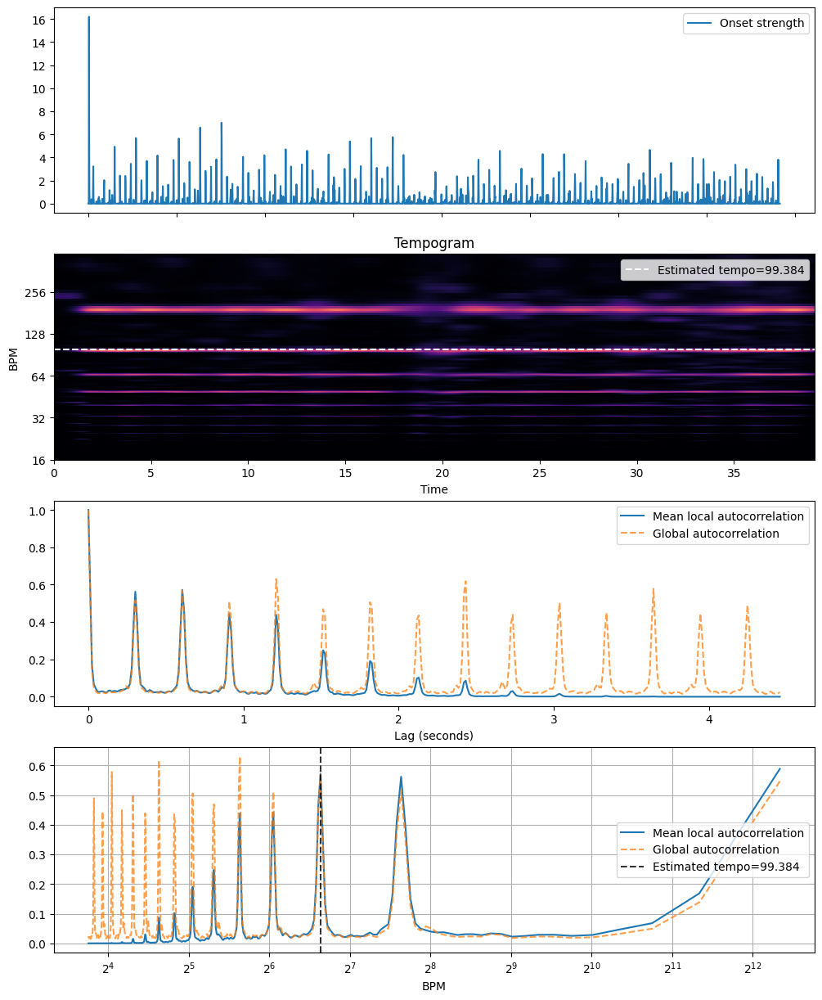

In [60]:
# Plot graphs
hop_length = 512

fig, ax = plt.subplots(nrows=4, figsize=(12, 15))
times = librosa.times_like(oenv_reg, sr=sr_reg, hop_length=hop_length)
ax[0].plot(times, oenv_reg, label='Onset strength')
ax[0].label_outer()
ax[0].legend(frameon=True)
librosa.display.specshow(tempogram_reg, sr=sr_reg, hop_length=hop_length,
                         x_axis='time', y_axis='tempo', cmap='magma',
                         ax=ax[1])

ax[1].axhline(tempo_reg, color='w', linestyle='--', alpha=1,
            label='Estimated tempo={:g}'.format(tempo_reg))
ax[1].legend(loc='upper right')
ax[1].set(title='Tempogram')
x = np.linspace(0, tempogram_reg.shape[0] * float(hop_length) / sr_reg,
                num=tempogram_reg.shape[0])

ax[2].plot(x, np.mean(tempogram_reg, axis=1), label='Mean local autocorrelation')
ax[2].plot(x, acg_reg, '--', alpha=0.75, label='Global autocorrelation')
ax[2].set(xlabel='Lag (seconds)')
ax[2].legend(frameon=True)

freqs = librosa.tempo_frequencies(tempogram_reg.shape[0], hop_length=hop_length, sr=sr_reg)
ax[3].semilogx(freqs[1:], np.mean(tempogram_reg[1:], axis=1),
             label='Mean local autocorrelation', base=2)
ax[3].semilogx(freqs[1:], acg_reg[1:], '--', alpha=0.75,
             label='Global autocorrelation', base=2)
ax[3].axvline(tempo_reg, color='black', linestyle='--', alpha=.8,
            label='Estimated tempo={:g}'.format(tempo_reg))
ax[3].legend(frameon=True)
ax[3].set(xlabel='BPM')
ax[3].grid(True)

There is minimal lag time between the mean local autocorrection and the global autocorrection. Based on the peaks, we have identified the beat times and tempo. This can be seen in the second graph, displaying the tempogram.

As mentioned, the tempogram shows the strength of an onset envelope. In other words, the brightest points mark the strongest strength which denotes the number of beats per minute. Therefore, we can conclude that the tempo of 'I Want It That Way' is 99.38bpm.

In the next part, we'll use some Librosa's functions to get the beat times based on the tempo.

In [61]:
# Define a function to find the tempo and beat of each audio

def find_tempo_beat(y, sr, audio):

    # Get the track from the dictionary
    tempo, beats = librosa.beat.beat_track(y=y, sr=sr)
    beat_times = librosa.frames_to_time(beats, sr=sr)
        
    print(audio)
    print(f'Tempo: {tempo:.2f} bpm')
    print(f'Beat times: {beat_times}')
    print()

In [62]:
# Define a function to find the tempo and beat of each audio
def find_beat_times(y, sr, audio):
    
    tempo, beats = librosa.beat.beat_track(y=y, sr=sr)
    beat_times = librosa.frames_to_time(beats, sr=sr)
    df = round(pd.DataFrame(beat_times), 2)
    df.rename(columns={0: 'beat_times'}, inplace=True)

    return df

In [63]:
# Apply function to find the tempo and beat times of each track
reg_tempo_beat = find_tempo_beat(y_reg, sr_reg, 'reg_track')
pulse_tempo_beat = find_tempo_beat(y_pulse, sr_pulse, 'pulse_track')
push_tempo_beat = find_tempo_beat(y_push, sr_push, 'push_track')
sc_tempo_beat = find_tempo_beat(y_sc, sr_sc, 'sc_track')

reg_track
Tempo: 99.38 bpm
Beat times: [3.48299320e-02 7.77868481e-01 1.48607710e+00 2.10140590e+00
 2.69351474e+00 3.30884354e+00 3.91256236e+00 4.51628118e+00
 5.12000000e+00 5.72371882e+00 6.32743764e+00 6.94276644e+00
 7.53487528e+00 8.15020408e+00 8.75392290e+00 9.35764172e+00
 9.96136054e+00 1.05650794e+01 1.11687982e+01 1.17841270e+01
 1.23762358e+01 1.29799546e+01 1.35952834e+01 1.41990023e+01
 1.48027211e+01 1.54180499e+01 1.60101587e+01 1.66254875e+01
 1.72292063e+01 1.78329252e+01 1.84366440e+01 1.90519728e+01
 1.96440816e+01 2.02594104e+01 2.08631293e+01 2.14900680e+01
 2.20821769e+01 2.26858957e+01 2.32896145e+01 2.39049433e+01
 2.45086621e+01 2.51123810e+01 2.57160998e+01 2.63314286e+01
 2.69351474e+01 2.75388662e+01 2.81425850e+01 2.87579138e+01
 2.93384127e+01 2.99653515e+01 3.05690703e+01 3.11843991e+01
 3.17765079e+01 3.23918367e+01 3.29839456e+01 3.35992744e+01
 3.42029932e+01 3.48183220e+01 3.54104308e+01 3.60257596e+01
 3.66178685e+01 3.72331973e+01 3.78369161e+01 

Since each choreography move was recorded with the same audio, I expect the beat times to be similar, probably just a few miliseconds off as the video's start and end vary a little.

In [64]:
# Apply function to find the tempo and beat times of each track
reg_beats = find_beat_times(y_reg, sr_reg, reg_track)
pulse_beats = find_beat_times(y_pulse, sr_pulse, pulse_track)
push_beats = find_beat_times(y_push, sr_push, push_track)
sc_beats = find_beat_times(y_sc, sr_sc, sc_track)

# Display results
print('reg_beats')
display(reg_beats.head(3))
print()
print('pulse_beats')
display(pulse_beats.head(3))
print()
print('push_beats')
display(push_beats.head(3))
print()
print('sc_beats')
display(sc_beats.head(3))
print()

reg_beats


,beat_times
0,0.03
1,0.78
2,1.49



pulse_beats


,beat_times
0,0.03
1,0.79
2,1.52



push_beats


,beat_times
0,0.03
1,0.84
2,1.44



sc_beats


,beat_times
0,0.03
1,0.78
2,1.38


Now that we have obtained the beat times of each recording, we shall plot them against the y-coordinates of the the **right shoulder, right elbow**, as well as **right heel**. Unlike determining the correctness of the choreo move, feet movement is important in determining if the rider is on beat. We are looking at just the vertical component as the minimum point of the rider's movement should fall on the beat of the soundtrack to be considered 'on beat'.

To make the codes cleaner, let's create new dataframes for each choreo move, consisting of just the `beat_time`, `timestamp`, `y_RIGHT_SHOULDER`, `y_RIGHT_ELBOW` and `y_RIGHT_HEEL`. 

In [65]:
# Re-importing df_choreo_cleaned.csv as df_choreo no longer contain y_RIGHT_HEEL.
df_choreo2 = pd.read_csv('data/df_choreo_cleaned.csv')
df_choreo2.head()

,choreo,timestamp,x_NOSE,y_NOSE,z_NOSE,v_NOSE,x_LEFT_EYE_INNER,y_LEFT_EYE_INNER,z_LEFT_EYE_INNER,v_LEFT_EYE_INNER,x_LEFT_EYE,y_LEFT_EYE,z_LEFT_EYE,v_LEFT_EYE,x_LEFT_EYE_OUTER,y_LEFT_EYE_OUTER,z_LEFT_EYE_OUTER,v_LEFT_EYE_OUTER,x_RIGHT_EYE_INNER,y_RIGHT_EYE_INNER,z_RIGHT_EYE_INNER,v_RIGHT_EYE_INNER,x_RIGHT_EYE,y_RIGHT_EYE,z_RIGHT_EYE,v_RIGHT_EYE,x_RIGHT_EYE_OUTER,y_RIGHT_EYE_OUTER,z_RIGHT_EYE_OUTER,v_RIGHT_EYE_OUTER,x_LEFT_EAR,y_LEFT_EAR,z_LEFT_EAR,v_LEFT_EAR,x_RIGHT_EAR,y_RIGHT_EAR,z_RIGHT_EAR,v_RIGHT_EAR,x_MOUTH_LEFT,y_MOUTH_LEFT,z_MOUTH_LEFT,v_MOUTH_LEFT,x_MOUTH_RIGHT,y_MOUTH_RIGHT,z_MOUTH_RIGHT,v_MOUTH_RIGHT,x_LEFT_SHOULDER,y_LEFT_SHOULDER,z_LEFT_SHOULDER,v_LEFT_SHOULDER,x_RIGHT_SHOULDER,y_RIGHT_SHOULDER,z_RIGHT_SHOULDER,v_RIGHT_SHOULDER,x_LEFT_ELBOW,y_LEFT_ELBOW,z_LEFT_ELBOW,v_LEFT_ELBOW,x_RIGHT_ELBOW,y_RIGHT_ELBOW,z_RIGHT_ELBOW,v_RIGHT_ELBOW,x_LEFT_WRIST,y_LEFT_WRIST,z_LEFT_WRIST,v_LEFT_WRIST,x_RIGHT_WRIST,y_RIGHT_WRIST,z_RIGHT_WRIST,v_RIGHT_WRIST,x_LEFT_PINKY,y_LEFT_PINKY,z_LEFT_PINKY,v_LEFT_PINKY,x_RIGHT_PINKY,y_RIGHT_PINKY,z_RIGHT_PINKY,v_RIGHT_PINKY,x_LEFT_INDEX,y_LEFT_INDEX,z_LEFT_INDEX,v_LEFT_INDEX,x_RIGHT_INDEX,y_RIGHT_INDEX,z_RIGHT_INDEX,v_RIGHT_INDEX,x_LEFT_THUMB,y_LEFT_THUMB,z_LEFT_THUMB,v_LEFT_THUMB,x_RIGHT_THUMB,y_RIGHT_THUMB,z_RIGHT_THUMB,v_RIGHT_THUMB,x_LEFT_HIP,y_LEFT_HIP,z_LEFT_HIP,v_LEFT_HIP,x_RIGHT_HIP,y_RIGHT_HIP,z_RIGHT_HIP,v_RIGHT_HIP,x_LEFT_KNEE,y_LEFT_KNEE,z_LEFT_KNEE,v_LEFT_KNEE,x_RIGHT_KNEE,y_RIGHT_KNEE,z_RIGHT_KNEE,v_RIGHT_KNEE,x_LEFT_ANKLE,y_LEFT_ANKLE,z_LEFT_ANKLE,v_LEFT_ANKLE,x_RIGHT_ANKLE,y_RIGHT_ANKLE,z_RIGHT_ANKLE,v_RIGHT_ANKLE,x_LEFT_HEEL,y_LEFT_HEEL,z_LEFT_HEEL,v_LEFT_HEEL,x_RIGHT_HEEL,y_RIGHT_HEEL,z_RIGHT_HEEL,v_RIGHT_HEEL,x_LEFT_FOOT_INDEX,y_LEFT_FOOT_INDEX,z_LEFT_FOOT_INDEX,v_LEFT_FOOT_INDEX,x_RIGHT_FOOT_INDEX,y_RIGHT_FOOT_INDEX,z_RIGHT_FOOT_INDEX,v_RIGHT_FOOT_INDEX,prompts,choreo_results
0,regular,0.02,0.502886,0.302178,-0.138683,0.999999,0.508675,0.289320,-0.128275,0.999998,0.512320,0.289663,-0.128313,0.999998,0.514802,0.290194,-0.128310,0.999998,0.497833,0.288338,-0.128907,0.999998,0.494348,0.288260,-0.128916,0.999997,0.491992,0.288403,-0.128897,0.999997,0.519739,0.297438,-0.071542,0.999995,0.488214,0.295727,-0.075562,0.999996,0.509616,0.321674,-0.118281,0.999999,0.496282,0.319983,-0.118937,0.999999,0.541419,0.392366,-0.053509,0.999997,0.462078,0.386223,-0.044752,0.999972,0.557617,0.475867,-0.074800,0.990922,0.441858,0.465039,-0.064400,0.988470,0.580738,0.516422,-0.184602,0.996360,0.418855,0.508430,-0.163661,0.994022,0.591834,0.527058,-0.207297,0.993728,0.406513,0.516427,-0.183632,0.989500,0.590868,0.521594,-0.223747,0.994577,0.408786,0.511276,-0.200111,0.990705,0.586395,0.517875,-0.194346,0.994155,0.414112,0.510042,-0.173362,0.990837,0.518879,0.563852,-0.009890,0.999965,0.476228,0.557246,0.009776,0.999897,0.513578,0.707357,-0.005310,0.980009,0.458764,0.650263,0.022100,0.960495,0.516013,0.827558,0.055844,0.988360,0.461598,0.725048,0.170757,0.862985,0.513719,0.841829,0.058415,0.841601,0.467540,0.729058,0.184190,0.613609,0.521440,0.885349,-0.001563,0.979084,0.452877,0.788873,0.160094,0.868487,regular,0
1,regular,0.03,0.502771,0.299656,-0.137963,0.999999,0.508528,0.286862,-0.127008,0.999998,0.512022,0.287007,-0.127043,0.999998,0.514455,0.287397,-0.127024,0.999998,0.497685,0.286474,-0.127852,0.999998,0.494209,0.286511,-0.127854,0.999997,0.491619,0.286860,-0.127822,0.999997,0.519457,0.294659,-0.068963,0.999995,0.488099,0.294442,-0.074350,0.999996,0.509399,0.317191,-0.117339,0.999999,0.496076,0.315611,-0.118274,0.999999,0.540996,0.389465,-0.051307,0.999997,0.461874,0.384727,-0.044523,0.999971,0.556646,0.469219,-0.073138,0.991014,0.442254,0.462587,-0.064568,0.988266,0.580445,0.515708,-0.182032,0.996376,0.419424,0.505592,-0.165914,0.993942,0.591622,0.526858,-0.205108,0.993691,0.407036,0.515687,-0.187853,0.989323,0.590167,0.521289,-0.221396,0.994541,0.408912,0.509605,-0.204493,0.990550,0.585598,0.517541,-0.191832,0.994130,0.414339,0.507484,-0.176052,0.990707,0.518512,0.559169,-0.009030,0.9999

In [66]:
# Create new dataframes - filter out just the choreo we want before creating new df
reg_choreo = df_choreo2[df_choreo2['choreo']=='regular']
reg_choreo = reg_choreo[['choreo', 'timestamp', 'y_RIGHT_SHOULDER', 'y_RIGHT_ELBOW', 'y_RIGHT_HEEL']]

pulse_choreo = df_choreo2[df_choreo2['choreo']=='pulse']
pulse_choreo = pulse_choreo[['choreo', 'timestamp', 'y_RIGHT_SHOULDER', 'y_RIGHT_ELBOW', 'y_RIGHT_HEEL']].reset_index(drop=True)

push_choreo = df_choreo2[df_choreo2['choreo']=='push']
push_choreo = push_choreo[['choreo', 'timestamp', 'y_RIGHT_SHOULDER', 'y_RIGHT_ELBOW', 'y_RIGHT_HEEL']].reset_index(drop=True)

sc_choreo = df_choreo2[df_choreo2['choreo']=='sexy_corners']
sc_choreo = sc_choreo[['choreo', 'timestamp', 'y_RIGHT_SHOULDER', 'y_RIGHT_ELBOW', 'y_RIGHT_HEEL']].reset_index(drop=True)

# Display
print('reg_choreo')
display(reg_choreo.tail(3))
print()
print('pulse_choreo')
display(pulse_choreo.tail(3))
print()
print('push_choreo')
display(push_choreo.tail(3))
print()
print('sc_choreo')
display(sc_choreo.tail(3))

reg_choreo


,choreo,timestamp,y_RIGHT_SHOULDER,y_RIGHT_ELBOW,y_RIGHT_HEEL
2340,regular,39.06,0.392161,0.492969,0.853924
2341,regular,39.07,0.391314,0.492615,0.848356
2342,regular,39.09,0.390899,0.491648,0.844565



pulse_choreo


,choreo,timestamp,y_RIGHT_SHOULDER,y_RIGHT_ELBOW,y_RIGHT_HEEL
2339,pulse,39.04,0.376345,0.437384,0.738951
2340,pulse,39.06,0.375079,0.437294,0.734978
2341,pulse,39.07,0.374494,0.437343,0.733374



push_choreo


,choreo,timestamp,y_RIGHT_SHOULDER,y_RIGHT_ELBOW,y_RIGHT_HEEL
2335,push,38.97,0.382162,0.446432,0.731012
2336,push,38.99,0.384010,0.446746,0.717554
2337,push,39.01,0.385539,0.447162,0.717472



sc_choreo


,choreo,timestamp,y_RIGHT_SHOULDER,y_RIGHT_ELBOW,y_RIGHT_HEEL
2342,sexy_corners,39.09,0.451055,0.531081,0.850017
2343,sexy_corners,39.11,0.450492,0.530264,0.847684
2344,sexy_corners,39.12,0.449982,0.521049,0.842464


With the new dataframes, let's plot line graphs to see if the minima of those coordinates match with the beat times. 

As Matplotlib's y-coordinates are inverted, the y_coordinates would be presented by '1 - y-coordinate'.

In [67]:
def plot_line(df1, df2):

    x=df1['timestamp']
    y_shoulder = 1 - df1['y_RIGHT_SHOULDER']
    y_elbow = 1 - df1['y_RIGHT_ELBOW']
    y_heel = 1 - df1['y_RIGHT_HEEL']

    # Create the line plot
    plt.figure(figsize=(10, 4))
    plt.plot(x, y_shoulder, label='y_RIGHT_SHOULDER', color='g')
    plt.plot(x, y_elbow, label='y_RIGHT_ELBOW', color='r')
    plt.plot(x, y_heel, label='y_RIGHT_HEEL', color='b')
    plt.xlabel('Timestamp')
    plt.ylabel('y_coordinates')
    plt.title('Right Heel, Elbow and Shoulder Over Time')

    # Create legend on top right
    plt.legend(bbox_to_anchor=(1.28, 1), loc='upper right')

    # Plot vertical lines that mark the beat times
    beat_times = df2['beat_times']
    for beat_time in beat_times:
        plt.axvline(x=beat_time, color='red', linestyle='--', label='Beat Time')

    # Set the limits for the x-axis and y-axis to focus on the first 10 sec
    plt.xlim(0, 10)

    # Show the plot
    plt.show()

regular:


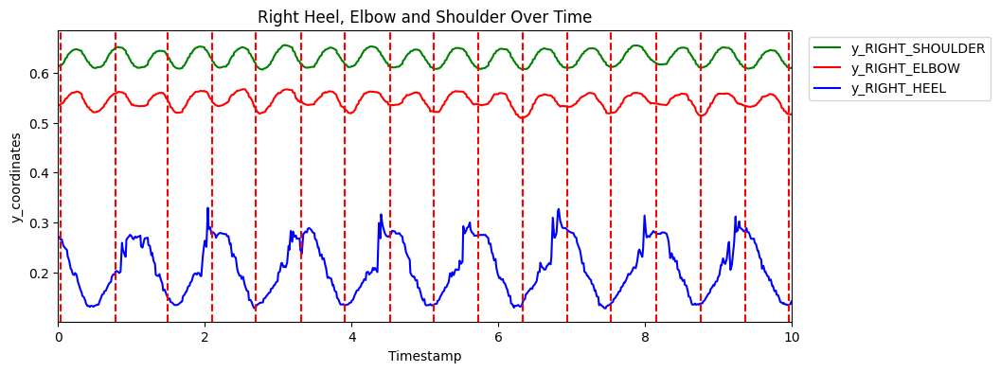

pulse:


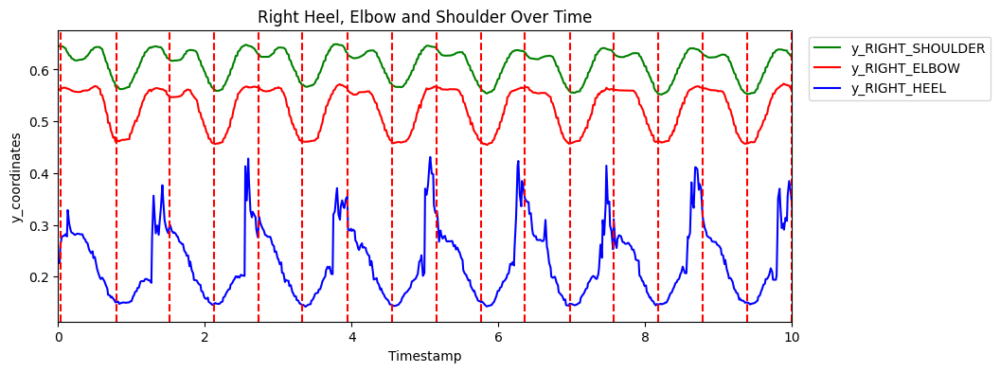

push:


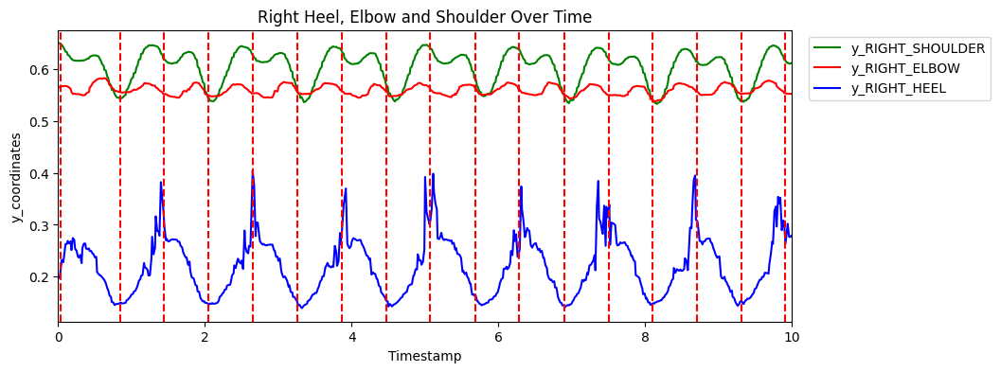

sexy_corners:


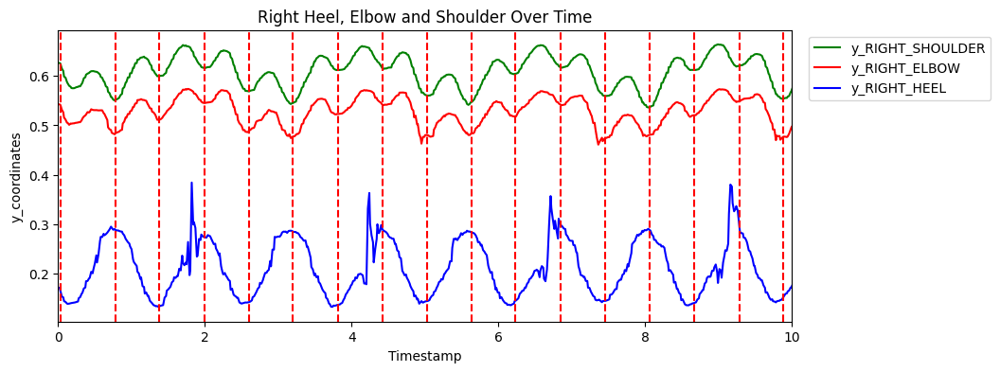

In [68]:
print('regular:')
plot_line(reg_choreo, reg_beats)
print('pulse:')
plot_line(pulse_choreo, pulse_beats)
print('push:')
plot_line(push_choreo, push_beats)
print('sexy_corners:')
plot_line(sc_choreo, sc_beats)

We shall zoom into the first 10 seconds for great clarity.

Technically, the rider is on the beat when the minimum points of each landmark coincide with the beat times. But it appears that this set of spin choreography was done in half time; the shoulders, elbows and right foot hit the minimum point every 2 beats. This is obvious in the `y_RIGHT_HEEL` lines (blue) where the beat times fall on every relative minima and maxima.

Focusing on the top body (shoulder and elbow), I noticed that I was just bobbing up and down consistently as I rode on the spot for `regular`. For `pulse` and `push`, there's a slight dip whenever I reached the maximum point caused by my footwork. Like in the 'Coordinates' section, `sexy_corners` is the most distinguishable from the four relative minimas in every set of sexy corners (low-low-high-high). Another trait that makes it different is that the other moves repeats in every 2 beats while `sexy_corners` repeats in every 4 beats.

Of all landmarks, `y_RIGHT_HEEL` has been the most consistent since the footwork does not vary with choreo moves. Thus, I will be using `y_RIGHT_HEEL` to determine if the rider is on beat.

### Identify Minima and Maxima
In this section, we will identify the minima and maxima of `y_RIGHT_HEEL` before comparing their associated `timestamp` with the `beat_time`. I have used frames=30 because there are 30 frames in each second and we want to compare each point with the next second or the second before.

Here's the confusing part - as Matplotlib inverts the y-coordinates, finding the **maximum points** would give us the minima and finding the **minimum points** would give us the maxima.

In [69]:
# Define a function to identify the relative minima of each class (n = number of positions)
def find_minima(coordinate, df, frames=30):
    s1 = df[coordinate].shift(frames)
    s2 = df[coordinate].shift(-frames)
    m1 = (s1 < df[coordinate]) & (s2 < df[coordinate])
    df_minima = pd.DataFrame({'timestamp': df[m1]['timestamp'], 'y_RIGHT_HEEL': df[m1][coordinate]})
    
    return df_minima

In [70]:
# Define a similar function to find the relative maxima
def find_maxima(coordinate, df, frames=30):
    s1 = df[coordinate].shift(frames)
    s2 = df[coordinate].shift(-frames)
    m1 = (s1 > df[coordinate]) & (s2 > df[coordinate])
    df_maxima = pd.DataFrame({'timestamp': df[m1]['timestamp'], 'y_RIGHT_HEEL': df[m1][coordinate]})
    
    return df_maxima

In [71]:
# Find minima
reg_minima = find_minima('y_RIGHT_HEEL', reg_choreo)
pulse_minima = find_minima('y_RIGHT_HEEL', pulse_choreo)
push_minima = find_minima('y_RIGHT_HEEL', push_choreo)
sc_minima = find_minima('y_RIGHT_HEEL', sc_choreo)

print('reg_minima')
display(reg_minima.tail(3))
print(len(reg_minima))
print()
print('pulse_minima')
display(pulse_minima.tail(3))
print(len(pulse_minima))
print()
print('push_minima')
display(push_minima.tail(3))
print(len(push_minima))
print()
print('sc_minima')
display(sc_minima.tail(3))
print(len(sc_minima))

reg_minima


,timestamp,y_RIGHT_HEEL
2278,38.02,0.824209
2279,38.04,0.815627
2280,38.05,0.818611


944

pulse_minima


,timestamp,y_RIGHT_HEEL
2309,38.54,0.818675
2310,38.56,0.813241
2311,38.57,0.810552


960

push_minima


,timestamp,y_RIGHT_HEEL
2305,38.47,0.835695
2306,38.49,0.836265
2307,38.51,0.836497


953

sc_minima


,timestamp,y_RIGHT_HEEL
2275,37.97,0.826340
2276,37.99,0.818210
2277,38.00,0.818083


930


In [72]:
# Find maxima
reg_maxima = find_maxima('y_RIGHT_HEEL', reg_choreo)
pulse_maxima = find_maxima('y_RIGHT_HEEL', pulse_choreo)
push_maxima = find_maxima('y_RIGHT_HEEL', push_choreo)
sc_maxima = find_maxima('y_RIGHT_HEEL', sc_choreo)

print('reg_maxima')
display(reg_maxima.tail())
print(len(reg_maxima))
print()
print('pulse_maxima')
display(pulse_maxima.tail())
print(len(pulse_maxima))
print()
print('push_maxima')
display(push_maxima.tail())
print(len(push_maxima))
print()
print('sc_maxima')
display(sc_maxima.tail())
print(len(sc_maxima))

reg_maxima


,timestamp,y_RIGHT_HEEL
2308,38.52,0.713255
2309,38.54,0.718842
2310,38.56,0.722170
2311,38.57,0.734095
2312,38.59,0.735991


955

pulse_maxima


,timestamp,y_RIGHT_HEEL
2273,37.94,0.735645
2274,37.95,0.742590
2275,37.97,0.738013
2276,37.99,0.759137
2277,38.00,0.757111


930

push_maxima


,timestamp,y_RIGHT_HEEL
2276,37.99,0.740490
2277,38.00,0.750809
2278,38.02,0.754448
2279,38.04,0.766422
2280,38.05,0.760899


932

sc_maxima


,timestamp,y_RIGHT_HEEL
2310,38.56,0.727545
2311,38.57,0.731844
2312,38.59,0.736293
2313,38.61,0.737207
2314,38.62,0.757137


956


Those functions have reduced the data size significantly and the sizes for minima and maxima are quite close to each other. This is a good indication that the minima and maxima have been picked up equally. 

Now let's plot out the coordinate points to visualise better.

In [73]:
# Define a function to plot the coordinate points
def plot_coord(df1, df2, df3):
    
    # Data for the y-axis
    y_HEEL = 1 - df1['y_RIGHT_HEEL']

    # Data for the x-axis (if 'timestamp' is the x-axis data)
    x = df1['timestamp']

    # Create the line plot
    plt.figure(figsize=(10, 4)) # Adjust the figure size as needed
    plt.plot(x, y_HEEL, label='y_RIGHT_HEEL', color='g')
    plt.xlabel('Timestamp')
    plt.ylabel('y-coordinates')
    plt.title('Line Plot of y_RIGHT_HEEL')
    plt.legend()

    # Mark the values as dots
    plt.scatter(df2['timestamp'], 1 - df2['y_RIGHT_HEEL'], color='blue', marker='o', label='Maxima Points')
    plt.scatter(df3['timestamp'], 1 - df3['y_RIGHT_HEEL'], color='purple', marker='o', label='Maxima Points')

    # Set the limits for the x-axis and y-axis to focus on the first 10 sec
    plt.xlim(0, 10)
    
    # Show the plot
    plt.show()

regular:


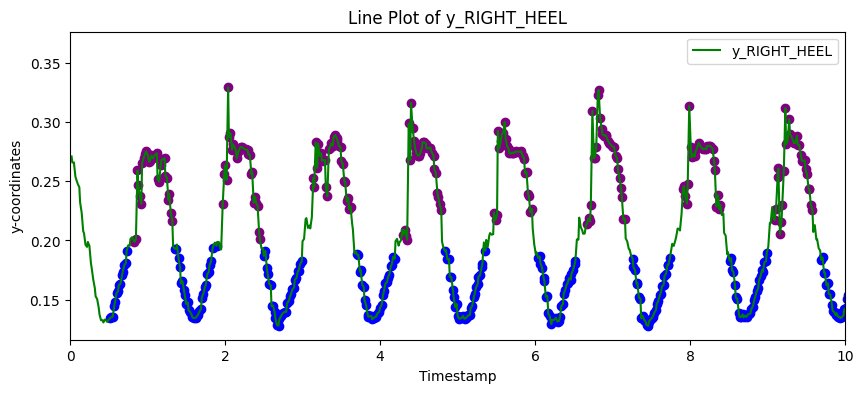

pulse:


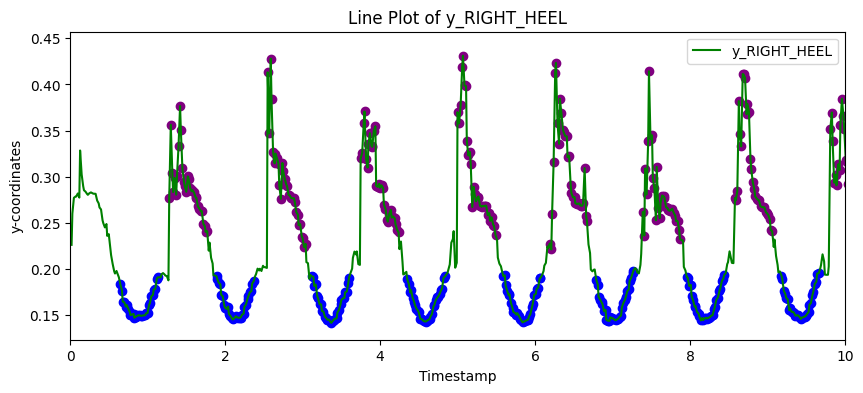

push:


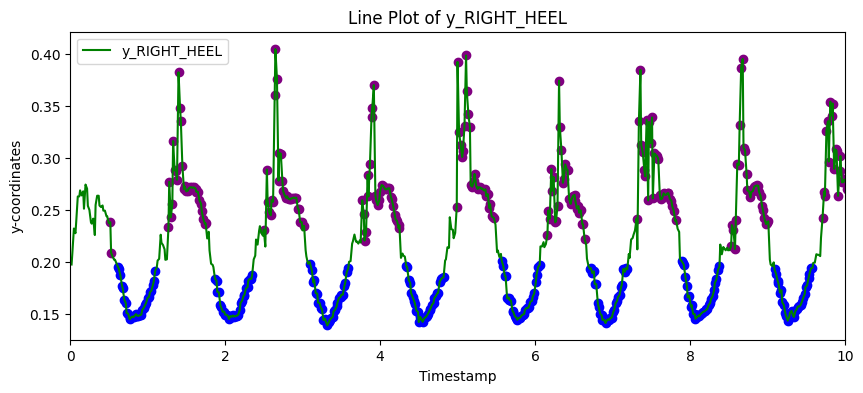

sexy_corners:


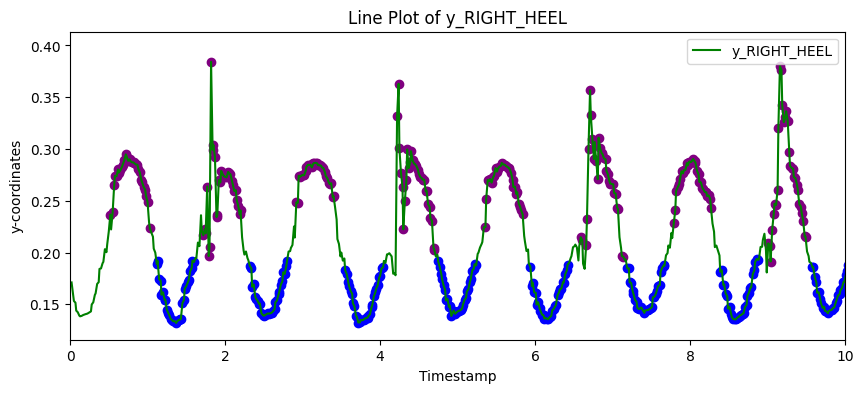

In [74]:
# Show plots: purple for maxima and blue for minima
print('regular:')
plot_coord(reg_choreo, reg_minima, reg_maxima)
print('pulse:')
plot_coord(pulse_choreo, pulse_minima, pulse_maxima)
print('push:')
plot_coord(push_choreo, push_minima, push_maxima)
print('sexy_corners:')
plot_coord(sc_choreo, sc_minima, sc_maxima)

It appears that the 'find_maxima' and 'find_minima' functions have returned a range of possible maxima and minima. We need just one maxima and minima to compare with the beat time. Thus, I will some functions to find the maximum of each group of maxima and the minimum of each group of minima.

Earlier when we retrieved the relative minima and maxima, the index was not reset. The first function, 'grouping', groups thems together if their indexes are consecutive. Otherwise, the minima/maxima shall join the next group. 

The second function, 'refining' then proceeds to find the minimum and maximum of the minima groups and maxima groups respectively, returning just one value at each trough and peak.

In [75]:
def grouping(df):
    
    j = 0
    k = 1
    
    df_groups = pd.DataFrame(columns=['group', 'timestamp', 'y_RIGHT_HEEL'])
    
    for i in range(len(df)-1):
        
        if i == 0:
            df_groups.loc[j] = df.loc[df.index[j]]
            df_groups['group'] = k
            
        elif df.index[i + 1] - df.index[i] >= 1 and df.index[i] - df.index[i - 1] == 1:
            df_groups.loc[j] = df.loc[df.index[j]]
            df_groups.loc[j, 'group'] = df_groups.iloc[len(df_groups) - 2, 0]
        
        elif df.index[i + 1] - df.index[i] == 1 and df.index[i] - df.index[i - 1] > 1:
            df_groups.loc[j] = df.loc[df.index[j]]
            df_groups.loc[j, 'group'] = (df_groups.iloc[len(df_groups) - 2, 0]) + 1
            
        else:
            df_groups.loc[j] = df.loc[df.index[j]]
            df_groups.loc[j, 'group'] = df_groups.iloc[len(df_groups) - 2, 0]
            
        j += 1
        df_groups['group'] = df_groups['group'].astype('int')
        
    return df_groups

In [76]:
def refine_minima(df, group_column):
    
    # Find the minimum of each group
    grouped_df = df.groupby(group_column).agg(y_RIGHT_HEEL=('y_RIGHT_HEEL', 'max'))
    
    # Merge with the original df to retain the 'timestamp' and drop 'group'
    min_df = df.merge(grouped_df, how='inner', on='y_RIGHT_HEEL').drop('group', axis=1)
    
    return min_df

In [77]:
def refine_maxima(df, group_column):
    
    # Find the maximum of each group
    grouped_df = df.groupby(group_column).agg(y_RIGHT_HEEL=('y_RIGHT_HEEL', 'min'))
    
    # Merge with the original df to retain the 'timestamp' and drop 'group'
    max_df = df.merge(grouped_df, how='inner', on='y_RIGHT_HEEL').drop('group', axis=1)
    
    return max_df

In [78]:
hi3 = refine_minima(grouping(reg_minima), 'group')
hi3.head()

,timestamp,y_RIGHT_HEEL
0,0.52,0.865468
1,1.37,0.807179
2,1.60,0.865570
3,2.69,0.871958
4,3.90,0.866576


In [79]:
# Refine minima
reg_min = refine_minima(grouping(reg_minima), 'group')
pulse_min = refine_minima(grouping(pulse_minima), 'group')
push_min = refine_minima(grouping(push_minima), 'group')
sc_min = refine_minima(grouping(sc_minima), 'group')

In [80]:
# Refine maxima
reg_max = refine_maxima(grouping(reg_maxima), 'group')
pulse_max = refine_maxima(grouping(pulse_maxima), 'group')
push_max = refine_maxima(grouping(push_maxima), 'group')
sc_max = refine_maxima(grouping(sc_maxima), 'group')

Let's plot the refined minima and maxima to see the results. I will zoom in to the 10-20th seconds this time to check if the functions work beyond the first 10 seconds.

In [81]:
# Add two more plots to the previous function along with the beat times. Mark the refined points in red.
def plot_coord_refined(df1, df2, df3, df4, df5):
    
    # Data for the y-axis
    y_HEEL = 1 - df1['y_RIGHT_HEEL']

    # Data for the x-axis (if 'timestamp' is the x-axis data)
    x = df1['timestamp']

    # Create the line plot
    plt.figure(figsize=(10, 4)) # Adjust the figure size as needed
    plt.plot(x, y_HEEL, label='y_RIGHT_HEEL', color='g')
    plt.xlabel('Timestamp')
    plt.ylabel('y-coordinates')
    plt.title('Line Plot of y_RIGHT_HEEL')
    plt.legend()

    # Mark the values as dots
    plt.scatter(df2['timestamp'], 1 - df2['y_RIGHT_HEEL'], color='blue', marker='o', label='Minima')
    plt.scatter(df3['timestamp'], 1 - df3['y_RIGHT_HEEL'], color='purple', marker='o', label='Maxima')
    plt.scatter(df4['timestamp'], 1 - df4['y_RIGHT_HEEL'], color='red', marker='o', label='Refined Miniima')
    plt.scatter(df5['timestamp'], 1 - df5['y_RIGHT_HEEL'], color='red', marker='o', label='Refined Maxima')

    # Set the limits for the x-axis and y-axis to focus on the first 10 sec
    plt.xlim(10, 20)
    
    # Show the plot
    plt.show()

regular:


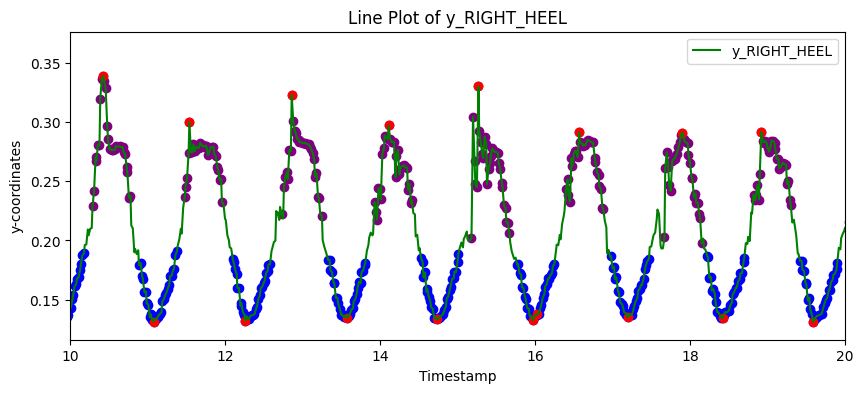

pulse:


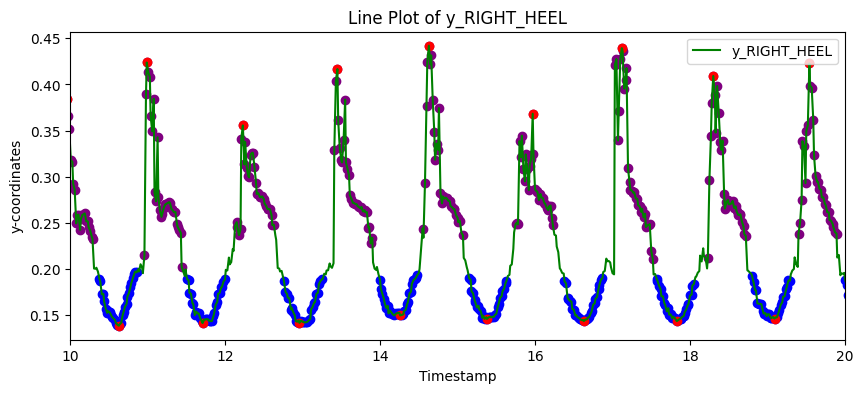

push:


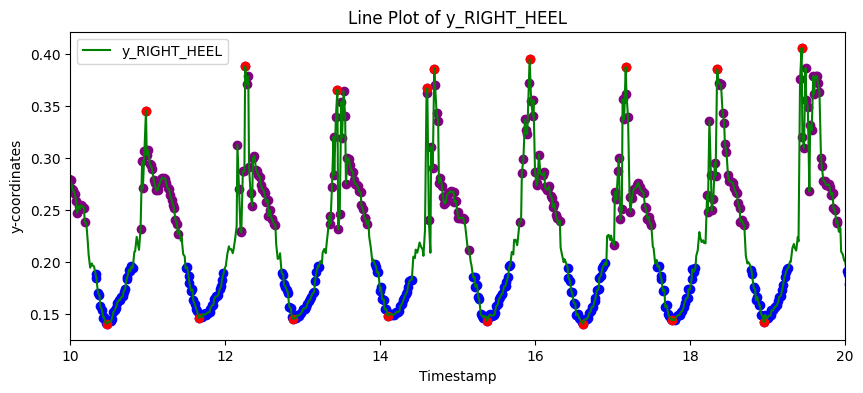

sexy_corners:


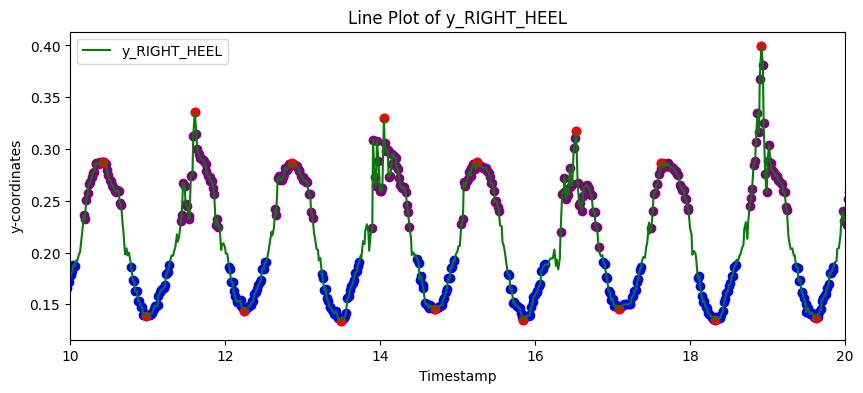

In [82]:
# Show plots: purple for maxima, blue for minima and red for the refined points
print('regular:')
plot_coord_refined(reg_choreo, reg_minima, reg_maxima, reg_min, reg_max)
print('pulse:')
plot_coord_refined(pulse_choreo, pulse_minima, pulse_maxima, pulse_min, pulse_max)
print('push:')
plot_coord_refined(push_choreo, push_minima, push_maxima, push_min, push_max)
print('sexy_corners:')
plot_coord_refined(sc_choreo, sc_minima, sc_maxima, sc_min, sc_max)

The refining functions have successfully identified all the minima and maxima of my right heel with just a few anomalies. As it is hard to achieve 100% accuracy in identifying the relative minima and maxima, we shall make do with the current result and explore more effective methods in the future.

Now, let's compare the red points with the beat times.

In [83]:
# Add two more plots to the previous function along with the beat times. Mark the refined points in red.
def check_beat(df1, df2, df3, df4):
    
    # Data for the y-axis
    y_HEEL = 1 - df1['y_RIGHT_HEEL']

    # Data for the x-axis (if 'timestamp' is the x-axis data)
    x = df1['timestamp']

    # Create the line plot
    plt.figure(figsize=(10, 4)) # Adjust the figure size as needed
    plt.plot(x, y_HEEL, label='y_RIGHT_HEEL', color='g')
    plt.xlabel('Timestamp')
    plt.ylabel('y-coordinates')
    plt.title('Line Plot of y_RIGHT_HEEL')
    plt.legend()

    # Mark the values as dots
    plt.scatter(df2['timestamp'], 1 - df2['y_RIGHT_HEEL'], color='red', marker='o', label='Refined Miniima')
    plt.scatter(df3['timestamp'], 1 - df3['y_RIGHT_HEEL'], color='red', marker='o', label='Refined Maxima')
    
    # Plot vertical lines that mark the beat times
    beat_times = df4['beat_times']
    for beat_time in beat_times:
        plt.axvline(x=beat_time, color='red', linestyle='--', label='Beat Time')

    # Set the limits for the x-axis and y-axis to focus on the first 10 sec
    plt.xlim(0, 2)
    
    # Show the plot
    plt.show()

regular:


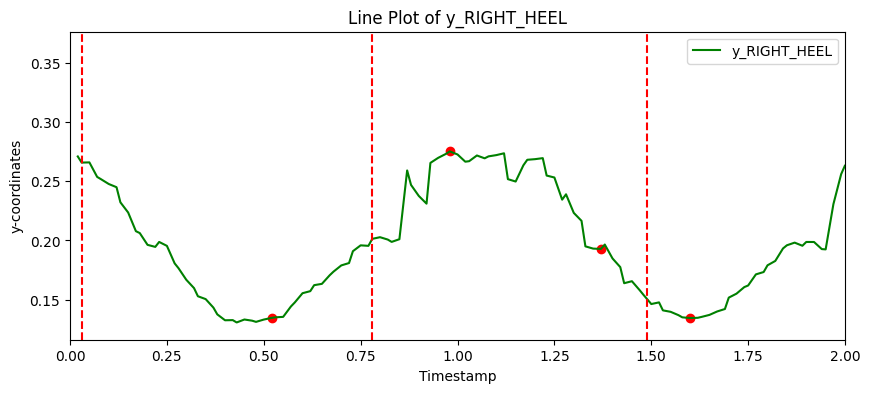

pulse:


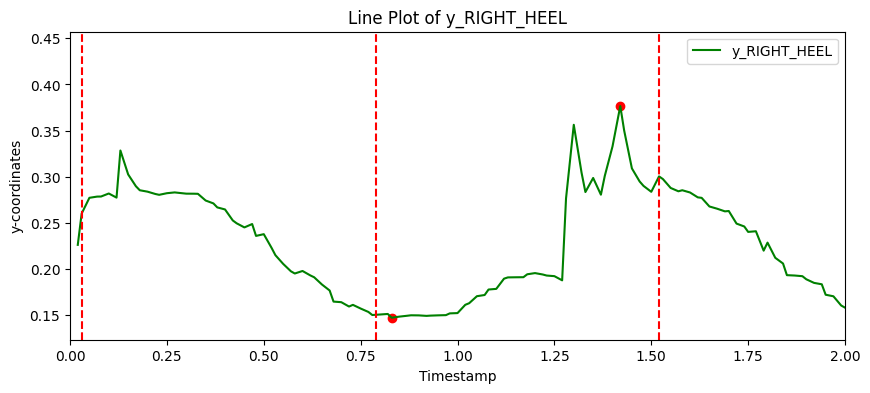

push:


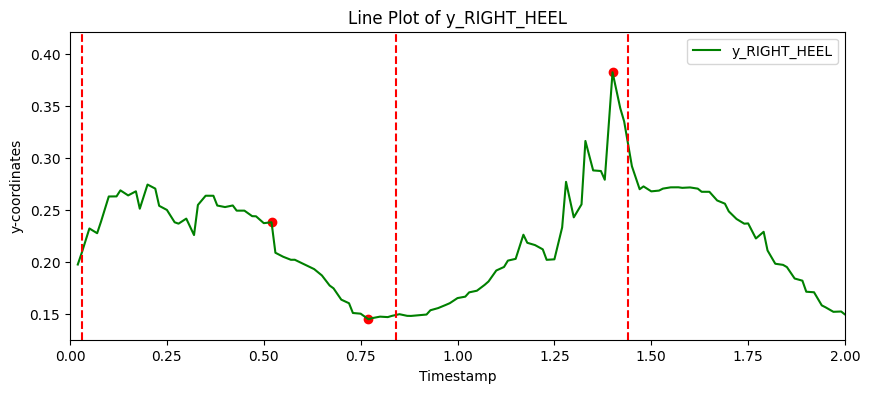

sexy_corners:


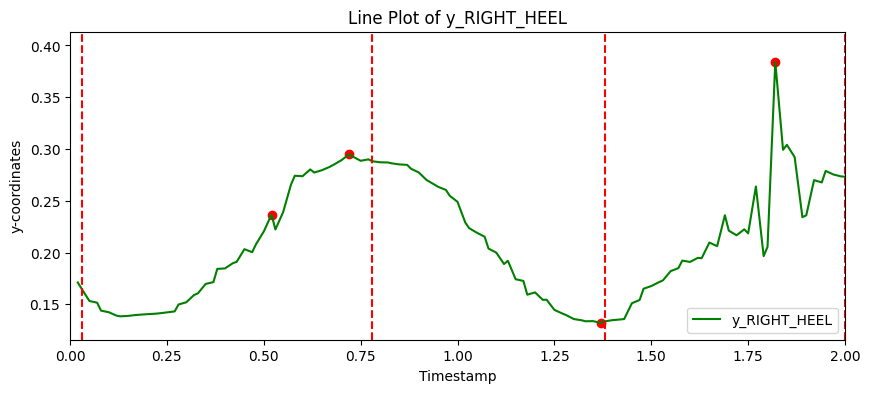

In [84]:
# Show plots: red for the refined points and red dotted line for beat times
print('regular:')
check_beat(reg_choreo, reg_min, reg_max, reg_beats)
print('pulse:')
check_beat(pulse_choreo, pulse_min, pulse_max, pulse_beats)
print('push:')
check_beat(push_choreo, push_min, push_max, push_beats)
print('sexy_corners:')
check_beat(sc_choreo, sc_min, sc_max, sc_beats)

While most red dots coincide with the red lines some are slightly off. If a point comes before the line, the rider is faster than the beat; if a point comes after the line, the rider is slower than the beat. 

Since it is impossible to achieve 100% accuracy all the time, the game shall provide some leeway. I will set varied ranges of time differences between the point and its closest line to determine how well the rider is following the beat.

In the next section, we will reorganise the dataframe to be used for modelling later.

Firstly, let's create new dataframes for each move, alternating each row with the minima and maxima.

In [85]:
# Define a function that creates a new dataframe with alternating minima and maxima
def alt_min_max(df_min, df_max):
    
    # Concatenate the two dfs on axis=0
    df = pd.concat([df_min, df_max], axis=0)
    
    # Sort index in ascending order then reset and remove the original index
    df = df.sort_index(axis=0).reset_index(drop=True)
    
    return df

In [86]:
# Apply function
df_reg = alt_min_max(reg_min, reg_max)
df_pulse = alt_min_max(pulse_min, pulse_max)
df_push = alt_min_max(push_min, push_max)
df_sc = alt_min_max(sc_min, sc_max)

# Display
print('df_reg')
display(df_reg.head(3))
print()
print('df_pulse')
display(df_pulse.head(3))
print()
print('df_push')
display(df_push.head(5))
print()
print('df_sc')
display(df_sc.head(5))
print()

df_reg


,timestamp,y_RIGHT_HEEL
0,0.52,0.865468
1,0.98,0.724785
2,1.37,0.807179



df_pulse


,timestamp,y_RIGHT_HEEL
0,0.83,0.852572
1,1.42,0.623351
2,2.10,0.854475



df_push


,timestamp,y_RIGHT_HEEL
0,0.77,0.855083
1,0.52,0.761906
2,1.40,0.617771
3,2.05,0.854821
4,2.65,0.595462



df_sc


,timestamp,y_RIGHT_HEEL
0,1.37,0.867988
1,0.52,0.763310
2,2.50,0.861058
3,0.72,0.705212
4,3.72,0.867569


Somehow the anomalies in `push` and `sexy_corners` have messed up the first minima in those two moves. I will remove them manually to get their `timestamp` running chronologically.

In [87]:
df_push = df_push.drop(index=0).reset_index(drop=True)
df_sc = df_sc.sort_values(by='timestamp', ascending=True).reset_index(drop=True)

print('df_push')
display(df_push.head(5))
print()
print('df_sc')
display(df_sc.head(5))
print()

df_push


,timestamp,y_RIGHT_HEEL
0,0.52,0.761906
1,1.40,0.617771
2,2.05,0.854821
3,2.65,0.595462
4,3.32,0.861047



df_sc


,timestamp,y_RIGHT_HEEL
0,0.52,0.763310
1,0.72,0.705212
2,1.37,0.867988
3,1.82,0.615802
4,2.50,0.861058


Another thing we need to do is to remove the first row of all the beat time dataframes. If you look at the last set of graphs, you'd realise that the beat starts instantly when the audio plays but no coordinate was captured there. To ensure we are comparing the coordinates with the right beat times, we need to remove the first beat time rows.

The first beat falls on 0.03s. We'll print the dataframes after dropping the first row to check that the dataframes do not begin with 0.03s and the values by row across all dataframes are close.

In [88]:
reg_beats1 = reg_beats.drop(index=0).reset_index(drop=True)
pulse_beats1 = pulse_beats.drop(index=0).reset_index(drop=True)
push_beats1 = push_beats.drop(index=0).reset_index(drop=True)
sc_beats1 = sc_beats.drop(index=0).reset_index(drop=True)

print('reg_beats1')
display(reg_beats1.head(3))
print()
print('pulse_beats1')
display(pulse_beats1.head(3))
print()
print('push_beats1')
display(push_beats1.head(3))
print()
print('sc_beats1')
display(sc_beats1.head(3))

reg_beats1


,beat_times
0,0.78
1,1.49
2,2.10



pulse_beats1


,beat_times
0,0.79
1,1.52
2,2.12



push_beats1


,beat_times
0,0.84
1,1.44
2,2.04



sc_beats1


,beat_times
0,0.78
1,1.38
2,2.00


Before concatenating these dataframes with the beat times, let's check their lengths.

In [89]:
print('Length of the y_RIGHT_HEEL dfs and beat time dfs respectively:')
print(len(df_reg), len(reg_beats1))
print(len(df_pulse), len(pulse_beats1))
print(len(df_push), len(push_beats1))
print(len(df_sc), len(sc_beats1))

Length of the y_RIGHT_HEEL dfs and beat time dfs respectively:
66 63
63 63
64 63
69 62


Concatenation would not work if the dataframes have different lengths. I will set a rule to concatenate to the length of the shorter dataframe (i.e. the last rows with no match will be dropped).

In [90]:
# Define a function to concatenate 2 dataframes to the length of the shorter dataframe
def concatenate(df1, df2):
    
    # Set rule
    if len(df1) < len(df2):
        df2_shortened = df2.head(len(df1))
        df3 = pd.concat([df1, df2_shortened], axis=1)
        
    elif len(df1) > len(df2):
        df1_shortened = df1.head(len(df2))
        df3 = pd.concat([df1_shortened, df2], axis=1)
        
    else:
        df3 = pd.concat([df1, df2], axis=1) # if both dfs have the same length
        
    return df3

In [91]:
df_reg = concatenate(df_reg, reg_beats1)
df_pulse = concatenate(df_pulse, pulse_beats1)
df_push = concatenate(df_push, push_beats1)
df_sc = concatenate(df_sc, sc_beats1)

print('df_reg')
display(df_reg.head(3))
print()
print('df_pulse')
display(df_pulse.head(3))
print()
print('df_push')
display(df_push.head(3))
print()
print('df_sc')
display(df_sc.head(3))

df_reg


,timestamp,y_RIGHT_HEEL,beat_times
0,0.52,0.865468,0.78
1,0.98,0.724785,1.49
2,1.37,0.807179,2.10



df_pulse


,timestamp,y_RIGHT_HEEL,beat_times
0,0.83,0.852572,0.79
1,1.42,0.623351,1.52
2,2.10,0.854475,2.12



df_push


,timestamp,y_RIGHT_HEEL,beat_times
0,0.52,0.761906,0.84
1,1.40,0.617771,1.44
2,2.05,0.854821,2.04



df_sc


,timestamp,y_RIGHT_HEEL,beat_times
0,0.52,0.763310,0.78
1,0.72,0.705212,1.38
2,1.37,0.867988,2.00


Now we'll add a new column, `time_diff`, for the time difference.

In [92]:
# Define a function to add the new column, 'time_diff'
def find_time_diff(df, col1, col2):
    
    df['time_diff'] = round((df[col1] - df[col2]), 2)
    
    return df

In [93]:
# Apply the function
df_reg = find_time_diff(df_reg, 'beat_times', 'timestamp')
df_pulse = find_time_diff(df_pulse, 'beat_times', 'timestamp')
df_push = find_time_diff(df_push, 'beat_times', 'timestamp')
df_sc = find_time_diff(df_sc, 'beat_times', 'timestamp')

# Display
print('df_reg')
display(df_reg.head(3))
print()
print('df_pulse')
display(df_pulse.head(3))
print()
print('df_push')
display(df_push.head(3))
print()
print('df_sc')
display(df_sc.head(3))

df_reg


,timestamp,y_RIGHT_HEEL,beat_times,time_diff
0,0.52,0.865468,0.78,0.26
1,0.98,0.724785,1.49,0.51
2,1.37,0.807179,2.10,0.73



df_pulse


,timestamp,y_RIGHT_HEEL,beat_times,time_diff
0,0.83,0.852572,0.79,-0.04
1,1.42,0.623351,1.52,0.10
2,2.10,0.854475,2.12,0.02



df_push


,timestamp,y_RIGHT_HEEL,beat_times,time_diff
0,0.52,0.761906,0.84,0.32
1,1.40,0.617771,1.44,0.04
2,2.05,0.854821,2.04,-0.01



df_sc


,timestamp,y_RIGHT_HEEL,beat_times,time_diff
0,0.52,0.763310,0.78,0.26
1,0.72,0.705212,1.38,0.66
2,1.37,0.867988,2.00,0.63


Finally, I am adding the time ranges to determine how well the rider is on the beat. The output will be the feedback for the rider.

In [94]:
# Set time range
def speed_result(df, column):
    
    feedback = []
    for value in df[column]:

        if value < -1.1:
            feedback.append('Wayyy too slow!')
        
        elif value > -0.9 and value <= -1.1:
            feedback.append('Go faster!')
        
        elif value < -0.7 and value >= -0.9:
            feedback.append('Go slightly faster')
        
        elif value < -0.5 and value >= -0.7:
            feedback.append('On beat')
            
        elif value <= 0.5 and value >= -0.5:
            feedback.append('Very precise')

        elif value > 0.5 and value <= 0.7:
            feedback.append('On beat')  

        elif value > 0.7 and value <= 0.9:
            feedback.append('Slow down a little')

        elif value > 0.9 and value <= 1.1:
            feedback.append('Slow down!')
        else:
            feedback.append('Wayyy too fast!')
    
    df['speed_result'] = feedback
    
    return df

The rules above show the rider's speed relative to the beat times. If the difference is in the negative range, the rider is slower than the tempo; if the difference is in the positive range, the rider is faster than the tempo. 

In an event where the rider is 0.82 sec behind the beat (this show as -0.82sec time_diff), the output will be 'Go slightly faster'. As the game displays the output, it is also giving the rider real time feedback.

In [95]:
# Apply the function
df_reg = speed_result(df_reg, 'time_diff')
df_pulse = speed_result(df_pulse, 'time_diff')
df_push = speed_result(df_push, 'time_diff')
df_sc = speed_result(df_sc, 'time_diff')

# Display
print('df_reg')
display(df_reg.head(3))
print()
print('df_pulse')
display(df_pulse.head(3))
print()
print('df_push')
display(df_push.head(3))
print()
print('df_sc')
display(df_sc.head(3))

df_reg


,timestamp,y_RIGHT_HEEL,beat_times,time_diff,speed_result
0,0.52,0.865468,0.78,0.26,Very precise
1,0.98,0.724785,1.49,0.51,On beat
2,1.37,0.807179,2.10,0.73,Slow down a little



df_pulse


,timestamp,y_RIGHT_HEEL,beat_times,time_diff,speed_result
0,0.83,0.852572,0.79,-0.04,Very precise
1,1.42,0.623351,1.52,0.10,Very precise
2,2.10,0.854475,2.12,0.02,Very precise



df_push


,timestamp,y_RIGHT_HEEL,beat_times,time_diff,speed_result
0,0.52,0.761906,0.84,0.32,Very precise
1,1.40,0.617771,1.44,0.04,Very precise
2,2.05,0.854821,2.04,-0.01,Very precise



df_sc


,timestamp,y_RIGHT_HEEL,beat_times,time_diff,speed_result
0,0.52,0.763310,0.78,0.26,Very precise
1,0.72,0.705212,1.38,0.66,On beat
2,1.37,0.867988,2.00,0.63,On beat


To prepare for modelling in the next notebook, let's concatenate all the dataframes into one and name it `df_tempo`.

In [96]:
df_tempo = pd.concat([df_reg, df_pulse, df_push, df_sc], axis=0).reset_index(drop=True)

df_tempo.head()

,timestamp,y_RIGHT_HEEL,beat_times,time_diff,speed_result
0,0.52,0.865468,0.78,0.26,Very precise
1,0.98,0.724785,1.49,0.51,On beat
2,1.37,0.807179,2.10,0.73,Slow down a little
3,2.04,0.670650,2.69,0.65,On beat
4,1.60,0.865570,3.31,1.71,Wayyy too fast!


In [97]:
# Save as csv for modelling
df_tempo.to_csv('data/df_tempo_modelling.csv', index=False)